# <u>**Global Climate Factors and Their Impact On Human Disease Burden**</u>

Contributors:
- Carl Chan
- Chiamaka Nnamani
- Patrick Russell

In [ ]:
pip install kagglehub

# 1: Data Collection and Preparation


## 1.1: Download and Read Data


The Global Climate-Health Impact Tracker (GCHIT) dataset was taken from https://www.kaggle.com/datasets/sohumgokhale/global-climate-health-impact-tracker-2015-2025.

In [ ]:
# # Could be used to directly upload files to the CoLab runtime
# from google.colab import files
# uploaded = files.upload()

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("sohumgokhale/global-climate-health-impact-tracker-2015-2025")

100%|██████████| 548k/548k [00:00<00:00, 20.6MB/s]

Extracting files...


In [ ]:
import os

import math
import numpy as np
import pandas as pd
import statsmodels.api as sm

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

file_path = os.path.join(path, "global_climate_health_impact_tracker_2015_2025.csv")
data = pd.read_csv(file_path)
data.head()

,record_id,country_code,country_name,region,income_level,date,year,month,week,latitude,...,air_quality_index,respiratory_disease_rate,cardio_mortality_rate,vector_disease_risk_score,waterborne_disease_incidents,heat_related_admissions,healthcare_access_index,gdp_per_capita_usd,mental_health_index,food_security_index
0,1,USA,United States,North America,High,2015-01-04,2015,1,1,37.09,...,82.0,69.4,31.5,6.6,16.2,1.4,77.3,63627.0,71.2,90.2
1,2,USA,United States,North America,High,2015-01-11,2015,1,2,37.09,...,6.0,70.0,26.3,5.2,11.4,0.0,83.6,63627.0,70.6,94.0
2,3,USA,United States,North America,High,2015-01-18,2015,1,3,37.09,...,137.0,66.9,33.4,1.3,19.5,0.0,84.7,63627.0,63.4,100.0
3,4,USA,United States,North America,High,2015-01-25,2015,1,4,37.09,...,-3.0,47.0,35.0,6.0,9.7,9.0,84.3,63627.0,68.1,96.4
4,5,USA,United States,North America,High,2015-02-01,2015,2,5,37.09,...,48.0,61.3,28.3,1.4,22.6,27.3,83.6,63733.0,69.1,100.0


## 1.2: Missing/Duplicated Data


In [ ]:
print("Missing data:", data.isna().any().any())
print("Duplicated data:", data.duplicated().any())

Missing data: False
Duplicated data: False


##  1.3: Process Categorical and Date Fields


In [ ]:
# Inspect what sort of data is in each column
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14100 entries, 0 to 14099
Data columns (total 30 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   record_id                     14100 non-null  int64  
 1   country_code                  14100 non-null  object 
 2   country_name                  14100 non-null  object 
 3   region                        14100 non-null  object 
 4   income_level                  14100 non-null  object 
 5   date                          14100 non-null  object 
 6   year                          14100 non-null  int64  
 7   month                         14100 non-null  int64  
 8   week                          14100 non-null  int64  
 9   latitude                      14100 non-null  float64
 10  longitude                     14100 non-null  float64
 11  population_millions           14100 non-null  int64  
 12  temperature_celsius           14100 non-null  float64
 13  t

### 1.3.1: Categorical Fields


#### 1.3.1.1: Convert Fields to Cateogry Data Type

In [ ]:
# Inspect the values in the categorical columns
categorical_cols = ["country_code", "country_name", "region", "income_level"]
for col in categorical_cols:
    print(data[col].value_counts())
    print()

country_code
USA    564
IND    564
CHN    564
BRA    564
NGA    564
DEU    564
JPN    564
GBR    564
FRA    564
AUS    564
KEN    564
MEX    564
IDN    564
PAK    564
BGD    564
EGY    564
ZAF    564
CAN    564
ESP    564
ITA    564
THA    564
PHL    564
VNM    564
ARG    564
COL    564
Name: count, dtype: int64

country_name
United States     564
India             564
China             564
Brazil            564
Nigeria           564
Germany           564
Japan             564
United Kingdom    564
France            564
Australia         564
Kenya             564
Mexico            564
Indonesia         564
Pakistan          564
Bangladesh        564
Egypt             564
South Africa      564
Canada            564
Spain             564
Italy             564
Thailand          564
Philippines       564
Vietnam           564
Argentina         564
Colombia          564
Name: count, dtype: int64

region
Europe            2820
Africa            2256
Southeast Asia    2256
North America     1

In [ ]:
data[categorical_cols] = data[categorical_cols].astype("category")

#### 1.3.1.2: Handle Ordinal Category Orders


In [ ]:
# Check the categories for income level (the other categorical fields are nominal)
data["income_level"].cat.categories

Index(['High', 'Lower-Middle', 'Upper-Middle'], dtype='object')

In [ ]:
# Order income level in ascending order
data["income_level"] = data["income_level"].cat.reorder_categories(['Lower-Middle', 'Upper-Middle', 'High'], ordered=True)
data["income_level"].dtype

CategoricalDtype(categories=['Lower-Middle', 'Upper-Middle', 'High'], ordered=True, categories_dtype=object)

### 1.3.2: Date Fields


In [ ]:
data["date"] = pd.to_datetime(data["date"], format="%Y-%m-%d")

## 1.4: Fix Data Quality Issues

The air_quality_index has 374 records with negative values, which is invalid (AQI should be 0-500). We'll clip these to 0.


In [ ]:
# Fix negative air_quality_index values by clipping to 0
print(f"Records with negative AQI before fix: {(data['air_quality_index'] < 0).sum()}")
data['air_quality_index'] = data['air_quality_index'].clip(lower=0)
print(f"Records with negative AQI after fix: {(data['air_quality_index'] < 0).sum()}")
print(f"AQI range after fix: {data['air_quality_index'].min():.1f} to {data['air_quality_index'].max():.1f}")


Records with negative AQI before fix: 374
Records with negative AQI after fix: 0
AQI range after fix: 0.0 to 302.0


## 1.5: Feature Engineering

Create additional features that may improve model performance:

1. **Rolling averages**: Capture cumulative climate effects (e.g., 4-week rolling mean of temperature)
2. **Interaction terms**: Capture how climate impacts vary by income level or region
    - Note that the lower-middle income group is encoded as 0, so any interaction term that multiplies another variable by income numeric will also evaluate to 0 for those rows. That category essentially becomes the baseline group with no interaction effect.


In [ ]:
def add_rolling_features(df, columns, windows=[4, 8], group_col='country_code'):
    """
    Add rolling mean features for specified columns.

    Args:
        df: DataFrame with time series data
        columns: Columns to create rolling features for
        windows: List of window sizes (in weeks)
        group_col: Column to group by (e.g., country_code)

    Returns:
        DataFrame with new rolling features added
    """
    result = df.copy()

    # Sort by date within each country
    result = result.sort_values(['country_code', 'date'])

    for col in columns:
        for window in windows:
            new_col_name = f'{col}_rolling_{window}w'
            result[new_col_name] = result.groupby(group_col, observed=True)[col].transform(
                lambda x: x.rolling(window=window, min_periods=1).mean()
            )

    return result

def add_interaction_features(df):
    """
    Add interaction terms between climate variables and socioeconomic factors.
    """
    result = df.copy()

    # Convert income_level to numeric for interactions
    income_map = {'Lower-Middle': 0, 'Upper-Middle': 1, 'High': 2}
    if result['income_level'].dtype.name == 'category':
        income_numeric = result['income_level'].cat.codes
    else:
        income_numeric = result['income_level'].map(income_map)

    # Temperature × Income Level interaction
    result['temp_x_income'] = result['temperature_celsius'] * income_numeric

    # Heat wave × Healthcare access interaction
    result['heatwave_x_healthcare'] = result['heat_wave_days'] * result['healthcare_access_index']

    # Air quality × Income level interaction
    result['aqi_x_income'] = result['air_quality_index'] * income_numeric

    # Extreme weather × GDP interaction (vulnerability measure)
    result['extreme_x_gdp'] = result['extreme_weather_events'] * result['gdp_per_capita_usd'] / 10000

    return result

# Create rolling features for key climate variables
climate_cols_for_rolling = ['temperature_celsius', 'temp_anomaly_celsius', 'pm25_ugm3', 'air_quality_index']
data_engineered = add_rolling_features(data, climate_cols_for_rolling, windows=[4, 8])

# Add interaction features
data_engineered = add_interaction_features(data_engineered)

print("New features added:")
new_cols = [c for c in data_engineered.columns if c not in data.columns]
print(new_cols)
print(f"\nTotal features: {len(data.columns)} -> {len(data_engineered.columns)}")


New features added:
['temperature_celsius_rolling_4w', 'temperature_celsius_rolling_8w', 'temp_anomaly_celsius_rolling_4w', 'temp_anomaly_celsius_rolling_8w', 'pm25_ugm3_rolling_4w', 'pm25_ugm3_rolling_8w', 'air_quality_index_rolling_4w', 'air_quality_index_rolling_8w', 'temp_x_income', 'heatwave_x_healthcare', 'aqi_x_income', 'extreme_x_gdp']

Total features: 30 -> 42


In [ ]:
# Compare model performance with and without engineered features
# This will be evaluated after we define the modeling functions below

# Update ignore_cols to exclude the new feature columns from being ignored
ignore_cols_engineered = ['record_id', "country_name", 'date', 'year', 'month']

# Note: We'll compare performance after the modeling section is set up
print("Feature engineering complete. We'll compare model performance below.")


Feature engineering complete. We'll compare model performance below.


## 1.6: Look at data distributions

Handle any non-normally distributed columns


In [ ]:
# Columns that we do not care about in a non-temporal (i.e. outside of time series analysis) regression
ignore_cols = ['record_id', "country_name", 'date', 'year', 'month']

# The variables we want to try predicting in our models
target_cols = [
    'respiratory_disease_rate', 'cardio_mortality_rate', 'vector_disease_risk_score',
    'waterborne_disease_incidents', 'heat_related_admissions', 'mental_health_index'
]

# We will consider everything else to be feature columns
feature_cols = data.columns.drop(target_cols).drop(ignore_cols)

# Variables we might want to normalize (via Box-Cox transformation)
continuous_variables = [
    "latitude", "longitude", "population_millions", "temperature_celsius",
    "temp_anomaly_celsius", "precipitation_mm", "heat_wave_days", "drought_indicator",
    "flood_indicator", "extreme_weather_events", "pm25_ugm3", "air_quality_index",
    "respiratory_disease_rate", "cardio_mortality_rate", "vector_disease_risk_score",
    "waterborne_disease_incidents", "heat_related_admissions", "healthcare_access_index",
    "gdp_per_capita_usd", "mental_health_index", "food_security_index"
]

In [ ]:
def plot_continuous_densities(data, columns):
    dim_horizontal = 3
    dim_vertical = math.ceil(len(columns) / dim_horizontal)

    fig, axs = plt.subplots(dim_vertical, dim_horizontal, figsize=(20,10))
    fig.subplots_adjust(hspace=0.7)

    for col, ax in zip(columns, axs.flat):
        data[col].plot.density(ax=ax)
        ax.set_title(col)
    plt.show()

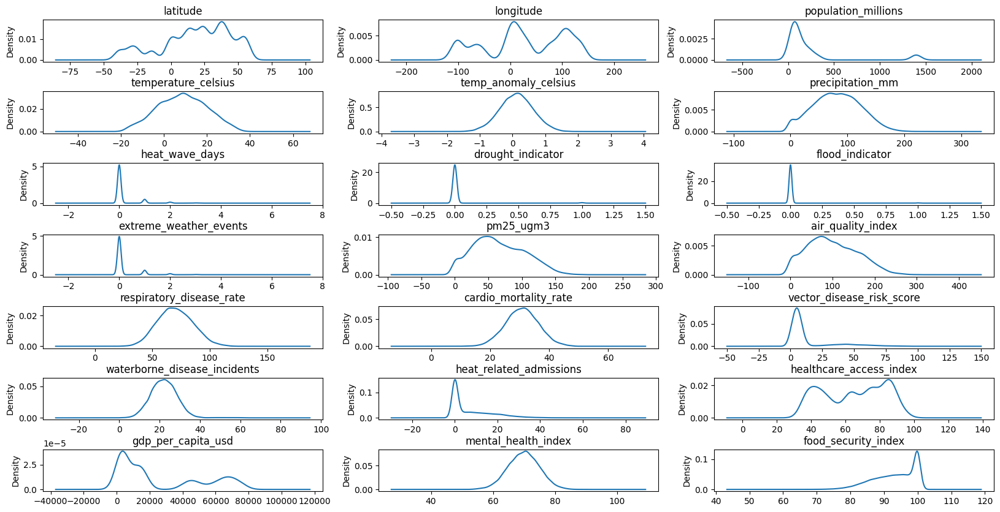

In [ ]:
plot_continuous_densities(data, continuous_variables)

### 1.6.1: Box-Cox Transformation


Now let us try applying a Box-Cox transformation to all the continuous columns we will use in the analysis. Then we can compare the results of using the transformed data to train machine learning models withs just using the original data.


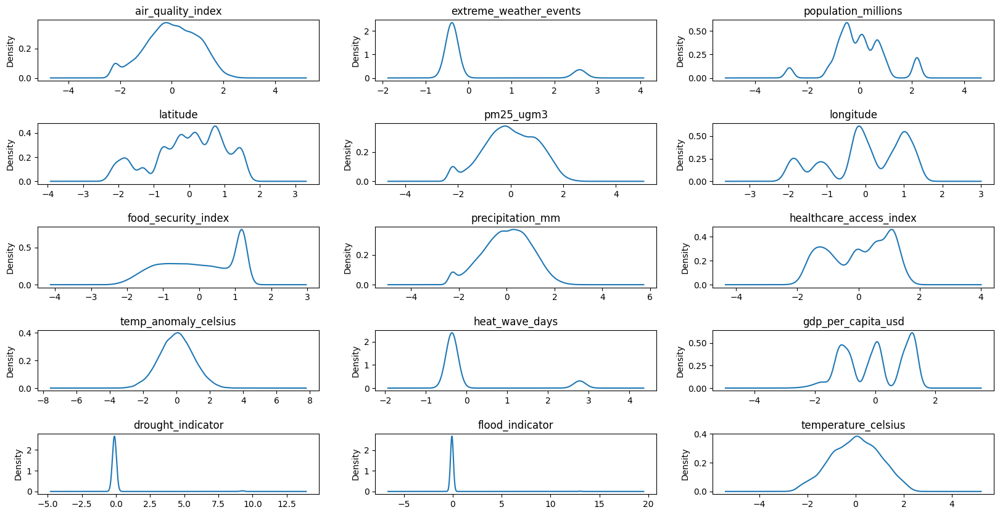

In [ ]:
from sklearn.preprocessing import PowerTransformer

# Perform Box-Cox transformation to non-normal variables, after shifting them
# up to be non-zero
boxcox_cols = list(set(continuous_variables) - set(target_cols))
power_transformer = PowerTransformer(method='box-cox', standardize=True)
transformed_data = power_transformer.fit_transform(
    data[boxcox_cols] - data[boxcox_cols].min() + 1
)
transformed_data = pd.DataFrame(transformed_data, columns=boxcox_cols)

# Reconstruct the original data frame with all the columns, but the transformed columns
transformed_data = transformed_data.join(data[data.columns.drop(boxcox_cols)])[data.columns]
plot_continuous_densities(transformed_data, boxcox_cols)

## 1.7: Looking for outliers


In [ ]:
def find_outliers_3sd(data, cols):
    """
    Finds outliers that are outside 3 standard deviations from the mean.
    """
    means = data[cols].mean()
    stds = data[cols].std()

    mask = (data[cols] < means-3*stds) | (data[cols] > means+3*stds)
    return data[mask.any(axis=1)]

def find_outliers_3iqr(data, cols):
    """
    Finds outliers that are outside 3 inter-quartile ranges from the median.
    """
    quartiles = data[cols].quantile([0.25, 0.5, 0.75])
    q1 = quartiles.loc[0.25]
    median = quartiles.loc[0.5]
    q3 = quartiles.loc[0.75]
    iqr = q3 - q1

    mask = (data[cols] < median-3*iqr) | (data[cols] > median+3*iqr)
    return data[mask.any(axis=1)]

In [ ]:
# Weather-related outliers in the original data
outlier_weather_cols = ["temperature_celsius", "temp_anomaly_celsius", "precipitation_mm", "heat_wave_days", "extreme_weather_events", "pm25_ugm3", "air_quality_index"]
weather_outliers = find_outliers_3sd(data, outlier_weather_cols)
print("Outlier shape:", weather_outliers.shape)
weather_outliers.head()

Outlier shape: (458, 30)


,record_id,country_code,country_name,region,income_level,date,year,month,week,latitude,...,air_quality_index,respiratory_disease_rate,cardio_mortality_rate,vector_disease_risk_score,waterborne_disease_incidents,heat_related_admissions,healthcare_access_index,gdp_per_capita_usd,mental_health_index,food_security_index
17,18,USA,United States,North America,High,2015-05-03,2015,5,18,37.09,...,80.0,67.4,30.1,2.7,26.8,25.4,77.7,64051.0,67.4,100.0
62,63,USA,United States,North America,High,2016-03-13,2016,3,10,37.09,...,74.0,62.8,30.4,6.4,15.7,52.7,87.1,65109.0,69.0,92.2
63,64,USA,United States,North America,High,2016-03-20,2016,3,11,37.09,...,113.0,70.7,29.1,0.9,14.8,46.8,83.2,65109.0,77.5,97.2
120,121,USA,United States,North America,High,2017-04-23,2017,4,16,37.09,...,26.0,42.4,44.3,3.0,27.9,27.7,82.7,66486.0,67.3,100.0
177,178,USA,United States,North America,High,2018-05-27,2018,5,21,37.09,...,99.0,76.6,28.3,8.1,24.3,27.9,84.0,67862.0,68.8,92.1


In [ ]:
# Health-related outliers in the original data
outlier_health_cols = ["respiratory_disease_rate", "cardio_mortality_rate", "vector_disease_risk_score", "waterborne_disease_incidents", "heat_related_admissions", "healthcare_access_index",
                       "mental_health_index", "food_security_index"]
health_outliers = find_outliers_3sd(data, outlier_health_cols)
print("Outlier shape:", health_outliers.shape)
health_outliers.head()

Outlier shape: (748, 30)


,record_id,country_code,country_name,region,income_level,date,year,month,week,latitude,...,air_quality_index,respiratory_disease_rate,cardio_mortality_rate,vector_disease_risk_score,waterborne_disease_incidents,heat_related_admissions,healthcare_access_index,gdp_per_capita_usd,mental_health_index,food_security_index
34,35,USA,United States,North America,High,2015-08-30,2015,8,35,37.09,...,61.0,63.5,48.9,8.4,17.9,0.0,80.2,64368.0,62.0,100.0
39,40,USA,United States,North America,High,2015-10-04,2015,10,40,37.09,...,52.0,71.6,34.2,7.5,12.9,0.0,80.1,64580.0,74.2,72.4
62,63,USA,United States,North America,High,2016-03-13,2016,3,10,37.09,...,74.0,62.8,30.4,6.4,15.7,52.7,87.1,65109.0,69.0,92.2
63,64,USA,United States,North America,High,2016-03-20,2016,3,11,37.09,...,113.0,70.7,29.1,0.9,14.8,46.8,83.2,65109.0,77.5,97.2
208,209,USA,United States,North America,High,2018-12-30,2018,12,52,37.09,...,43.0,57.1,40.9,4.8,1.9,0.0,81.7,68603.0,67.9,100.0


In [ ]:
# Still many potential outliers in box-cox transformed data, but fewer than before
transformed_outliers = find_outliers_3sd(transformed_data, continuous_variables)
print("Outlier shape:", transformed_outliers.shape)
transformed_outliers.head()

Outlier shape: (874, 30)


,record_id,country_code,country_name,region,income_level,date,year,month,week,latitude,...,air_quality_index,respiratory_disease_rate,cardio_mortality_rate,vector_disease_risk_score,waterborne_disease_incidents,heat_related_admissions,healthcare_access_index,gdp_per_capita_usd,mental_health_index,food_security_index
30,31,USA,United States,North America,High,2015-08-02,2015,8,31,0.708382,...,-0.181791,77.9,25.7,7.1,23.8,0.0,0.917925,1.222336,61.1,-2.113019
34,35,USA,United States,North America,High,2015-08-30,2015,8,35,0.708382,...,-0.542257,63.5,48.9,8.4,17.9,0.0,0.841736,1.222336,62.0,1.197601
39,40,USA,United States,North America,High,2015-10-04,2015,10,40,0.708382,...,-0.717450,71.6,34.2,7.5,12.9,0.0,0.836646,1.225143,74.2,-2.199996
62,63,USA,United States,North America,High,2016-03-13,2016,3,10,0.708382,...,-0.304060,62.8,30.4,6.4,15.7,52.7,1.189588,1.232114,69.0,-0.345652
63,64,USA,United States,North America,High,2016-03-20,2016,3,11,0.708382,...,0.336743,70.7,29.1,0.9,14.8,46.8,0.993789,1.232114,77.5,0.582135


# 2: Visualization


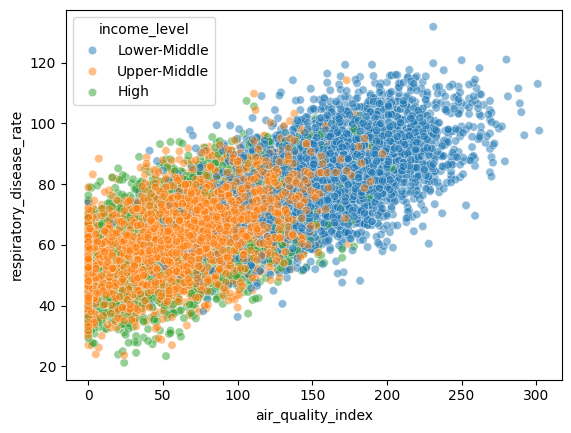

In [ ]:
sns.scatterplot(data=data, x="air_quality_index", y="respiratory_disease_rate", hue="income_level", alpha=0.5)
plt.show()

In [ ]:
feature_cols

Index(['country_code', 'region', 'income_level', 'week', 'latitude',
       'longitude', 'population_millions', 'temperature_celsius',
       'temp_anomaly_celsius', 'precipitation_mm', 'heat_wave_days',
       'drought_indicator', 'flood_indicator', 'extreme_weather_events',
       'pm25_ugm3', 'air_quality_index', 'healthcare_access_index',
       'gdp_per_capita_usd', 'food_security_index'],
      dtype='object')

## 2.1: Scatter Plot of All Features vs. All Targets


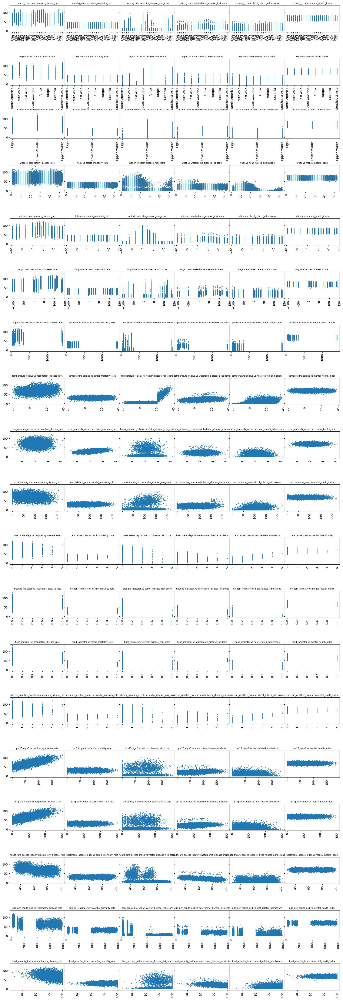

In [ ]:
fig, axs = plt.subplots(nrows=len(feature_cols), ncols=len(target_cols), figsize=(20, 60), sharey=True)
fig.subplots_adjust(hspace=1, wspace=0)

for f, feature_col in  enumerate(feature_cols):
    for t, target_col in  enumerate(target_cols):
        ax = axs[f, t]
        ax.scatter(data[feature_col], data[target_col], s=1)
        ax.set_title(feature_col + " vs " + target_col, fontsize=7)
        ax.tick_params(axis='x', labelrotation=90)

plt.show()

## 2.2: Pairplots


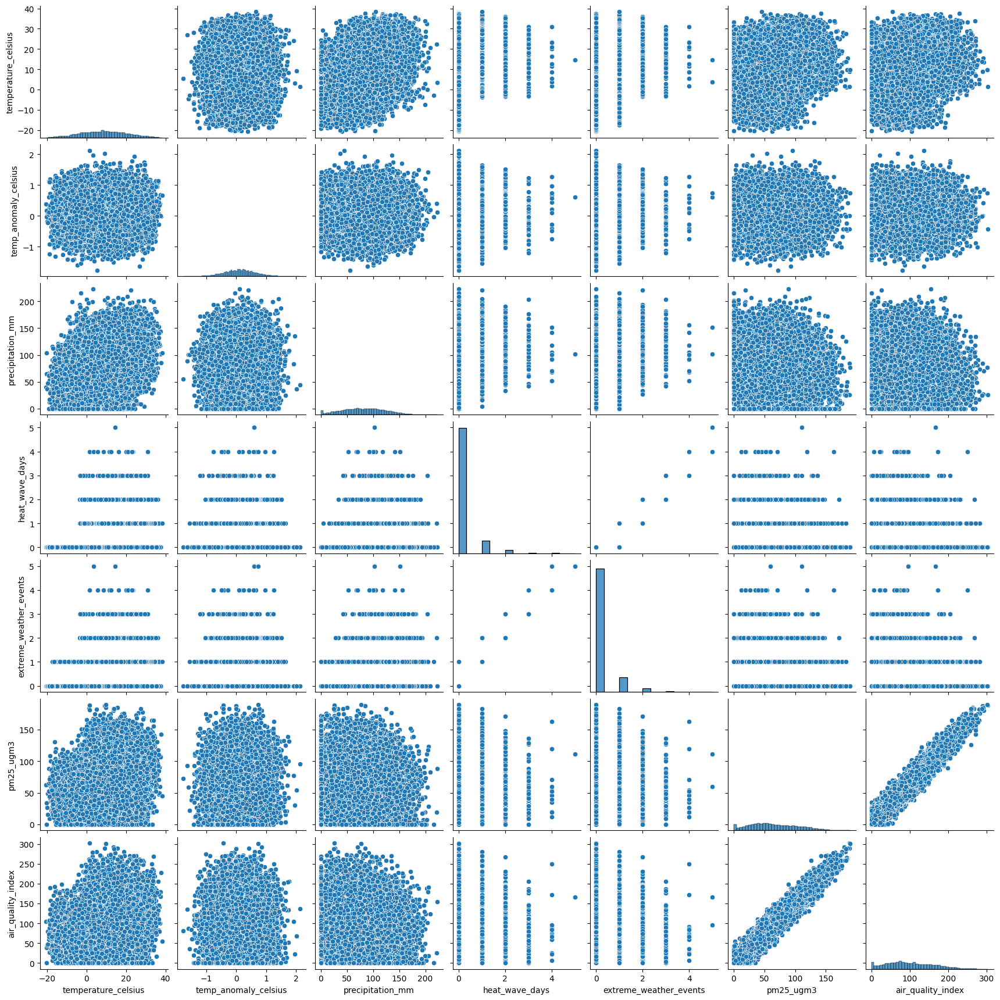

In [ ]:
sns.pairplot(data=data, vars=outlier_weather_cols)
plt.show()

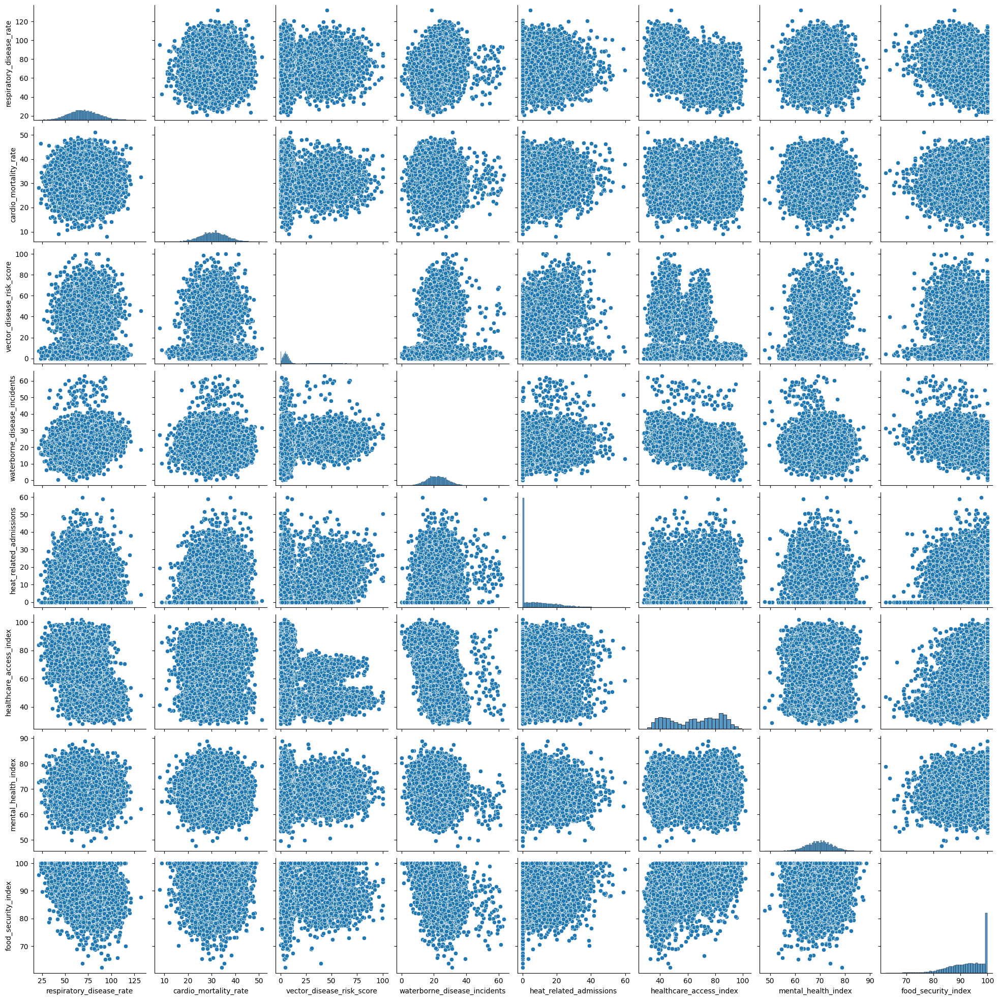

In [ ]:
sns.pairplot(data=data, vars=outlier_health_cols)
plt.show()

Splitting up the plots by income level shows some interesting underlying patterns.


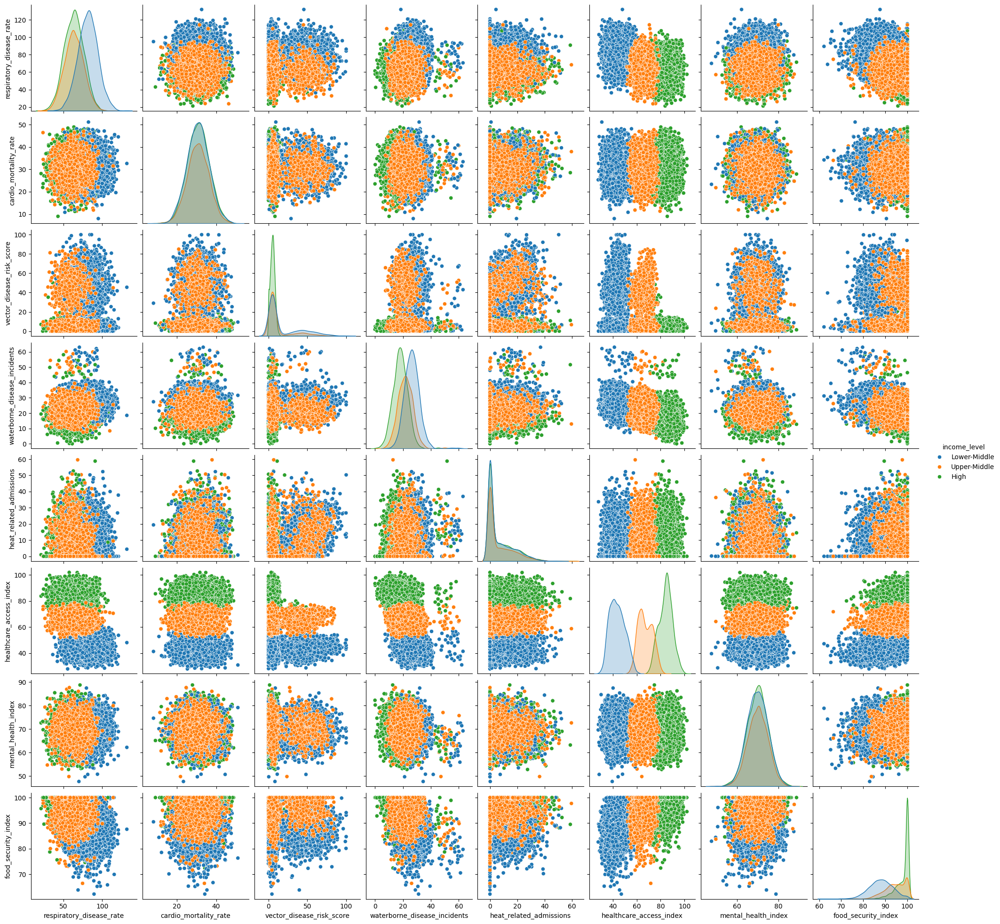

In [ ]:
sns.pairplot(data=data, vars=outlier_health_cols, hue="income_level")
plt.show()

## 2.3: Time Series Plots


In [ ]:
df_date_indexed = data.set_index("date").sort_index()
df_trans_date_indexed = transformed_data.set_index("date").sort_index()
df_by_country = df_date_indexed.groupby("country_code", observed=True)
df_by_region = df_date_indexed.groupby("region", observed=True)
df_by_income = df_date_indexed.groupby("income_level", observed=True)

In [ ]:
# Helper function for pandas version compatibility
def get_month_end_freq():
    """
    Get the correct month-end frequency code for the pandas version.
    Older pandas: 'M', Newer pandas: 'ME'
    """
    try:
        # Try the newer format first
        pd.date_range('2020-01-01', periods=2, freq='ME')
        return 'ME'
    except ValueError:
        # Fall back to older format
        return 'M'

MONTH_END_FREQ = get_month_end_freq()
print(f"Using month-end frequency: '{MONTH_END_FREQ}'")


Using month-end frequency: 'ME'


### 2.3.1: Plot Continous Columns Over Time


In [ ]:
def plot_monthly(df, cols, transparency=0.5, agg_func="mean"):
    num_horizontal = 3
    num_vertical = math.ceil(len(cols) / num_horizontal)
    fig, axs = plt.subplots(num_vertical, num_horizontal,
                            figsize=(6 * num_horizontal, 3 * num_vertical))
    fig.subplots_adjust(hspace=0.5, wspace=0.2)

    monthly_data = df[cols].resample(MONTH_END_FREQ).agg(agg_func)
    for col, ax in zip(cols, axs.flat):
        monthly_data[col].plot(alpha=transparency, ax=ax)
        ax.set_title(col)
    plt.show()

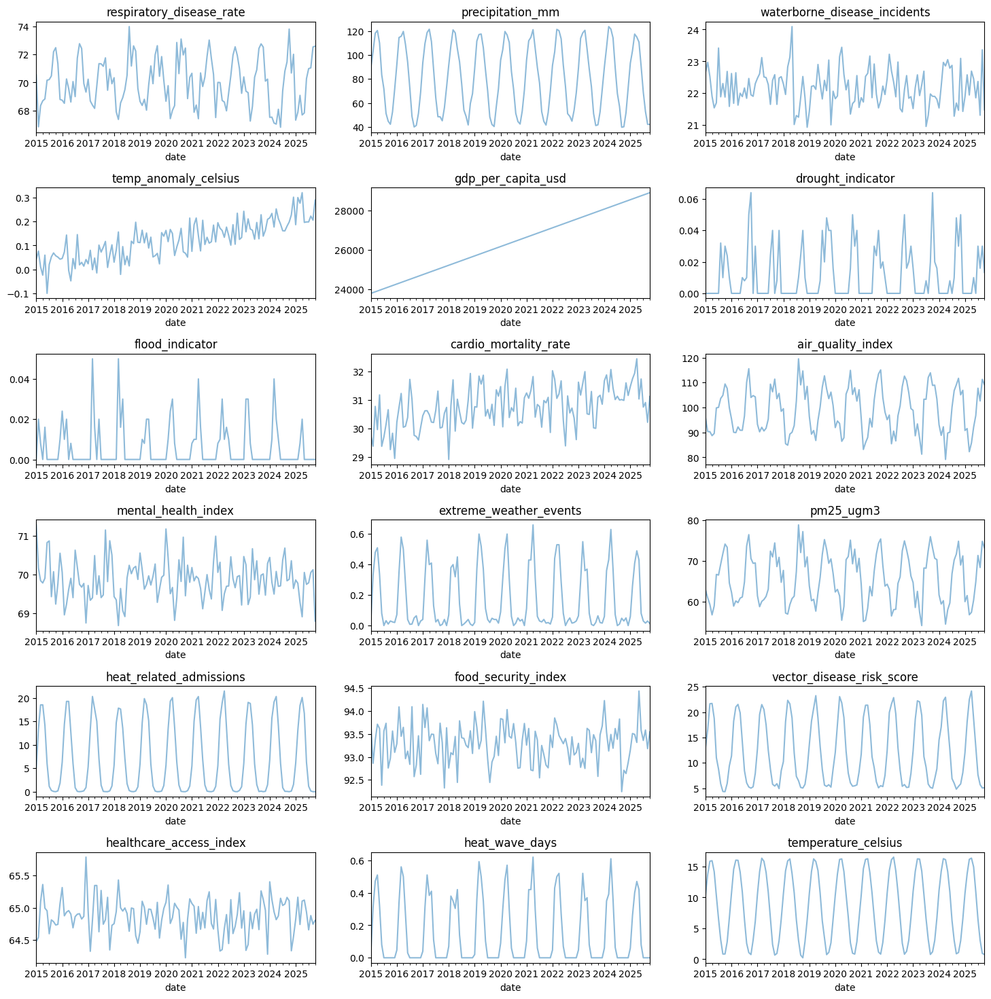

In [ ]:
# Remove some columns that we are not too interested in for analysis
columns_to_plot = list(set(continuous_variables) - set(["latitude", "longitude", "population_millions"]))
plot_monthly(df_date_indexed, columns_to_plot)

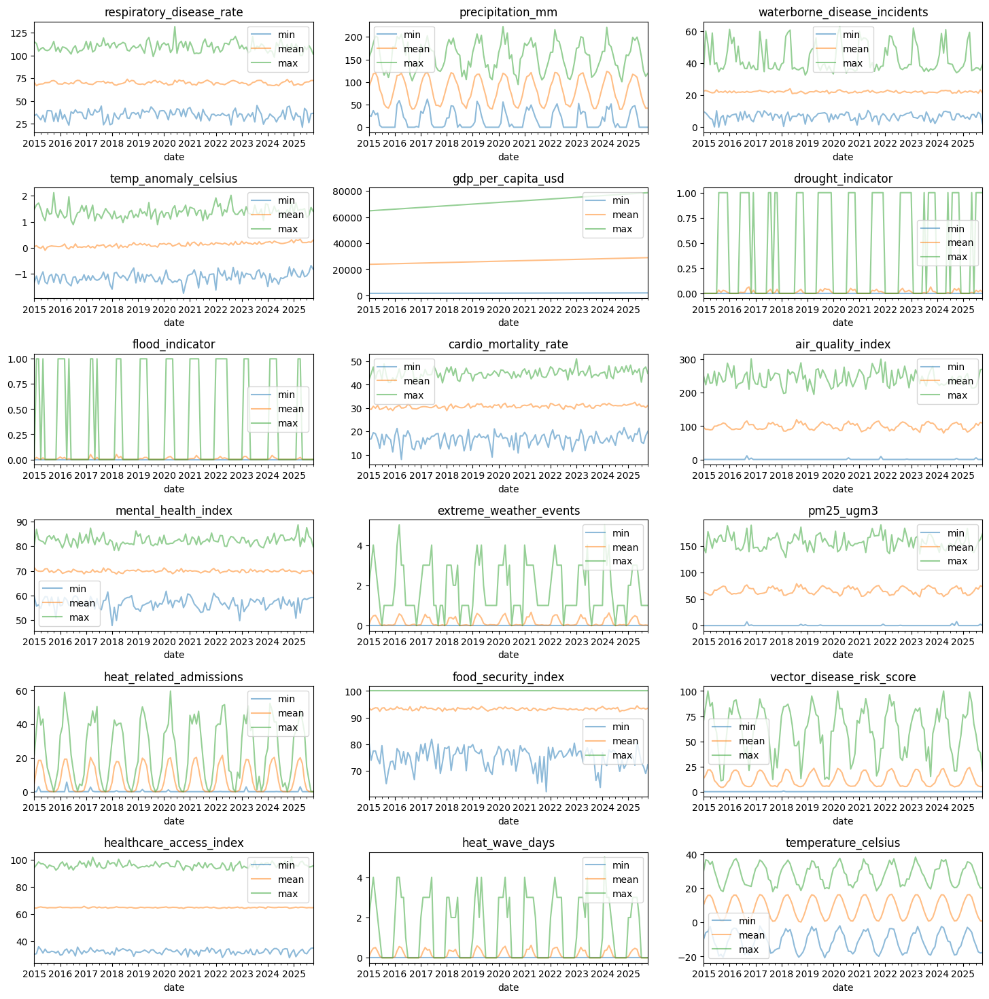

In [ ]:
# Now show the mean alongside the min and max of each month, to give a sense of range
plot_monthly(df_date_indexed, columns_to_plot, agg_func=["min", "mean", "max"])

### 2.3.2: Break Down By Income Level


In [ ]:
def plot_monthly_by_groups(df, group_col, plot_cols, transparency=0.5):
    fig, axs = plt.subplots(3, 3, figsize=(20,10))    # The sets of health and weather columns just happened to both have 9 columns
    fig.subplots_adjust(hspace=0.3)

    monthly_data = df.groupby(group_col, observed=True)[plot_cols].resample(MONTH_END_FREQ).mean().unstack().T
    for col, ax in zip(plot_cols, axs.flat):
        monthly_data.loc[col].plot(alpha=transparency, ax=ax)
        ax.set_title(col)
    plt.show()

def plot_yearly_by_groups(df, group_col, plot_cols, transparency=0.5):
    num_hor_plots = 3
    num_ver_plots = math.ceil(len(plot_cols) / num_hor_plots)
    fig, axs = plt.subplots(num_ver_plots, num_hor_plots, figsize=(20,10))
    fig.subplots_adjust(hspace=0.3)

    # Using pivot table instead of groupby like with monthly func, to demonstrate we are able to use it.
    yearly_df = df.pivot_table(
        index="year", columns=group_col, values=plot_cols, aggfunc="mean", observed=True
    )

    for col, ax in zip(plot_cols, axs.flat):
        yearly_df[col].plot(alpha=transparency, ax=ax)
        ax.set_title(col)
    plt.show()

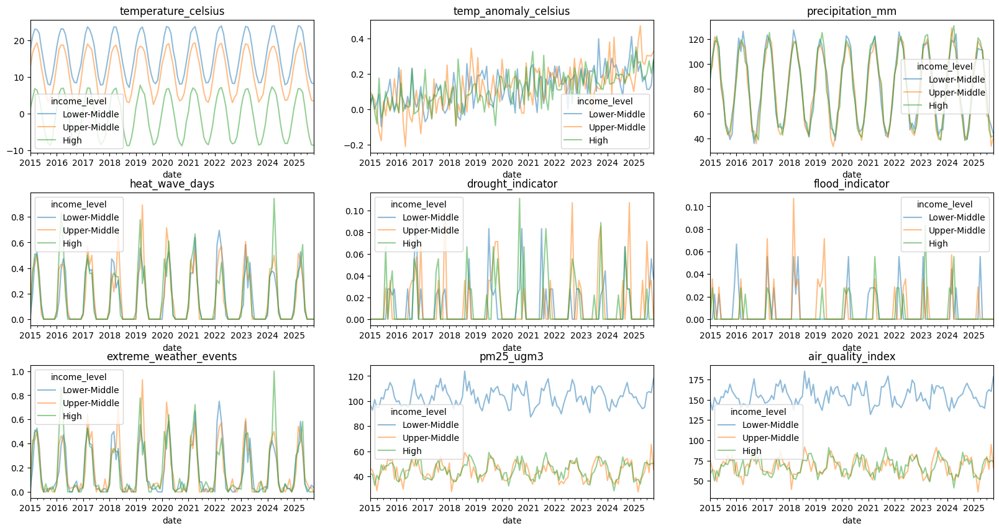

In [ ]:
weather_cols = ["temperature_celsius", "temp_anomaly_celsius", "precipitation_mm", "heat_wave_days", "drought_indicator", "flood_indicator", "extreme_weather_events", "pm25_ugm3", "air_quality_index"]
plot_monthly_by_groups(df_date_indexed, "income_level", weather_cols)

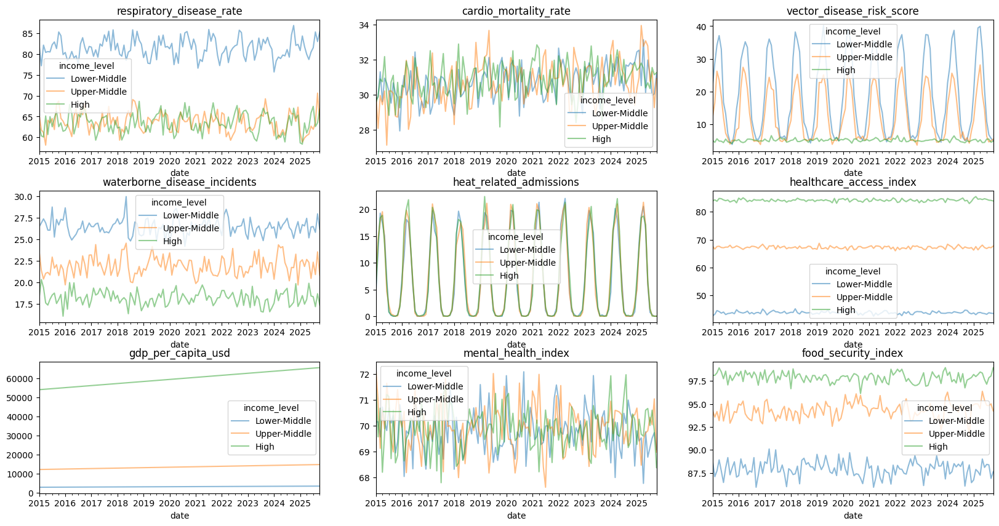

In [ ]:
health_cols = ["respiratory_disease_rate", "cardio_mortality_rate", "vector_disease_risk_score", "waterborne_disease_incidents", "heat_related_admissions", "healthcare_access_index",
               "gdp_per_capita_usd", "mental_health_index", "food_security_index"]
plot_monthly_by_groups(df_date_indexed, "income_level", health_cols)

### 2.3.3: Autocorrelation


In [ ]:
def plot_autocorr_by_groups_multi(df, group_col, value_cols, autocorr_ver="pandas", transparency=0.5, freq=None):
    """
    df              DataFrame
    group_col       Name of column to group by. One autocorrelation plot done for each unique value in this column.
    value_col       Name of column to get values to perform autocorrelation on.
    autocorr_ver    Version of autocorrelation plot function. Supported:
                        - "pandas": pd.plotting.autocorrelation_plot
                        - "statsmodels": sm.graphics.tsa.plot_acf
    freq            Resampling frequency (defaults to month-end)
    """
    if freq is None:
        freq = MONTH_END_FREQ

    autocorr_funcs = {
        "pandas": pd.plotting.autocorrelation_plot,
        "statsmodels": sm.graphics.tsa.plot_acf
    }
    autocorr_func = autocorr_funcs.get(autocorr_ver)
    if not autocorr_func:
        raise ValueError("{} not valid autocorr func source".format(autocorr_ver))

    # Each of the value columns gets its own plot, arranged in 3 columns of plots
    num_hor_plots = 3
    num_ver_plots = math.ceil(len(value_cols) / num_hor_plots)
    fig, axs = plt.subplots(num_ver_plots, num_hor_plots, figsize=(20,10))
    fig.subplots_adjust(hspace=0.3)

    group_vals = df[group_col].unique()
    grouped_data = df.groupby(group_col, observed=True)[value_cols].resample(freq).mean()

    for value_col, ax in zip(value_cols, axs.flat):
        for group_val in group_vals:
            autocorr_func(
                grouped_data.loc[group_val, value_col].values.squeeze(),
                ax=ax, label=group_val, alpha=transparency
            )
            ax.set_title(value_col)
    plt.legend()
    plt.show()

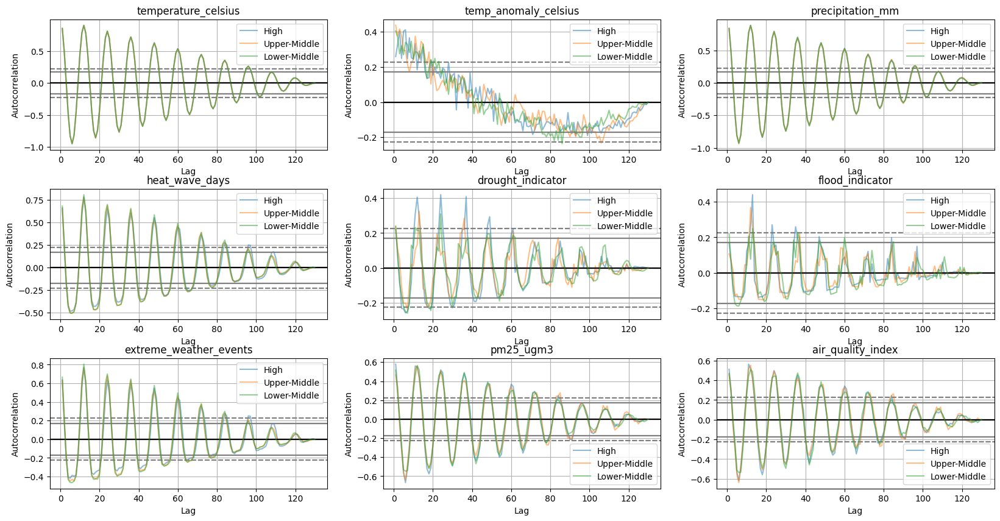

In [ ]:
plot_autocorr_by_groups_multi(df_date_indexed, "income_level", weather_cols)

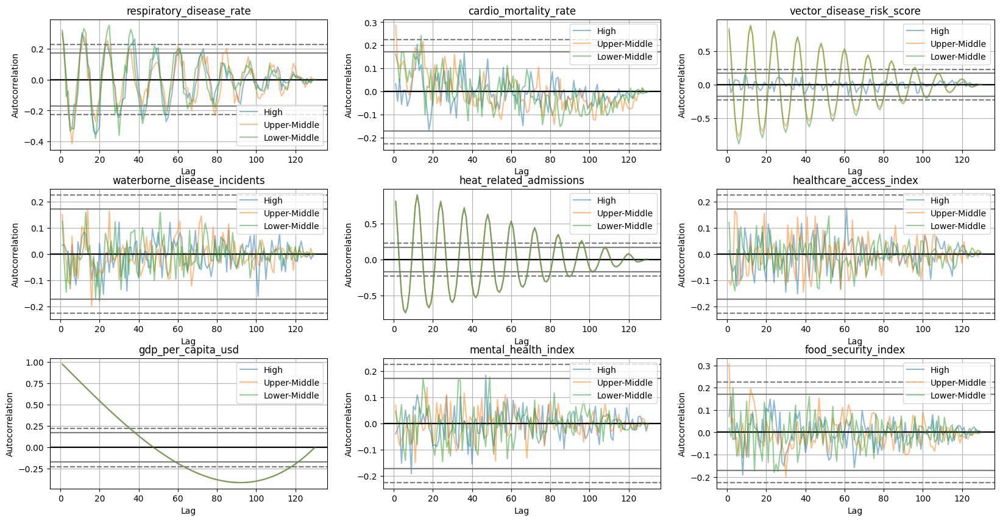

In [ ]:
plot_autocorr_by_groups_multi(df_date_indexed, "income_level", health_cols)

### 2.3.4: Temporal Decomposition

Decomposing time series data into trend, seasonality, and residual plots after grouping the data according to the values of some other column (e.g. income level).


In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

def plot_seasonal_decompose(series, label, period, axs):
    decomposed = seasonal_decompose(series, model="additive", period=period)

    decomposed.trend.plot(ax=axs[0], label=label)
    decomposed.seasonal.plot(ax=axs[1], label=label)
    decomposed.resid.plot(ax=axs[2], label=label)

def plot_grouped_seasonal_decompose(df, group_col, value_col, period_months):
    fig, axs = plt.subplots(3,1, figsize=(20,6))
    fig.suptitle("Temporal Decomposition: {} ({}-month period)".format(value_col, period_months), fontsize=20)
    axs[0].set_ylabel("trend", fontsize=16)
    axs[1].set_ylabel("seasonality", fontsize=16)
    axs[2].set_ylabel("residual", fontsize=16)

    monthly_data = df.groupby(group_col, observed=True)[value_col].resample(MONTH_END_FREQ).mean()
    for val in monthly_data.index.levels[0]:
        plot_seasonal_decompose(monthly_data.loc[val], val, period_months, axs)

    plt.legend()
    plt.show()

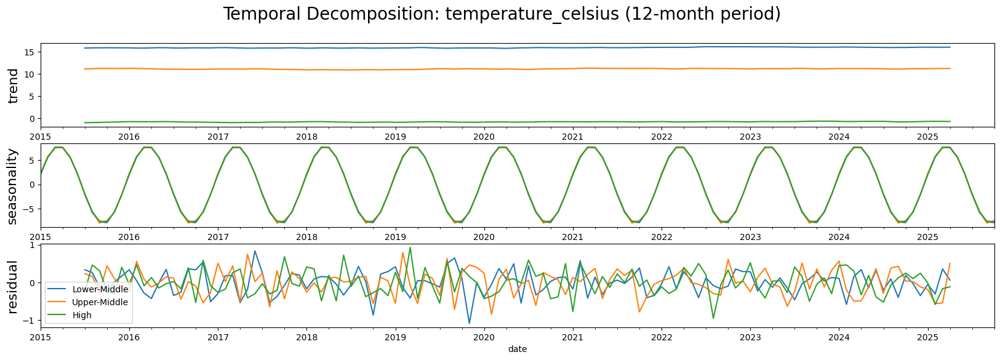

In [ ]:
plot_grouped_seasonal_decompose(df_date_indexed, "income_level", "temperature_celsius", 12)

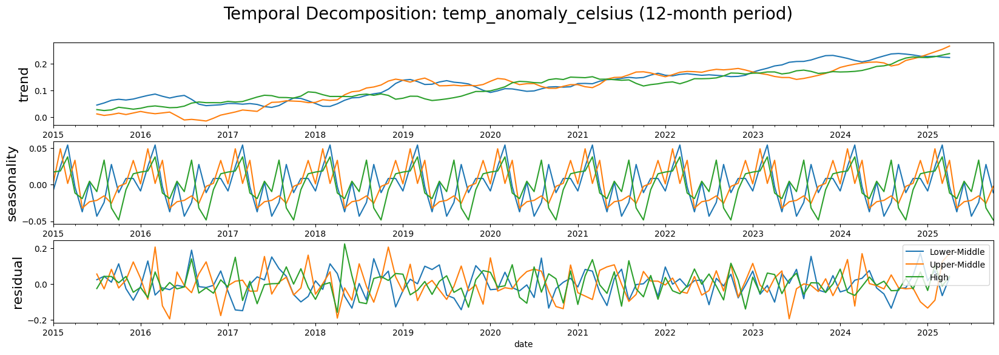

In [ ]:
plot_grouped_seasonal_decompose(df_date_indexed, "income_level", "temp_anomaly_celsius", 12)

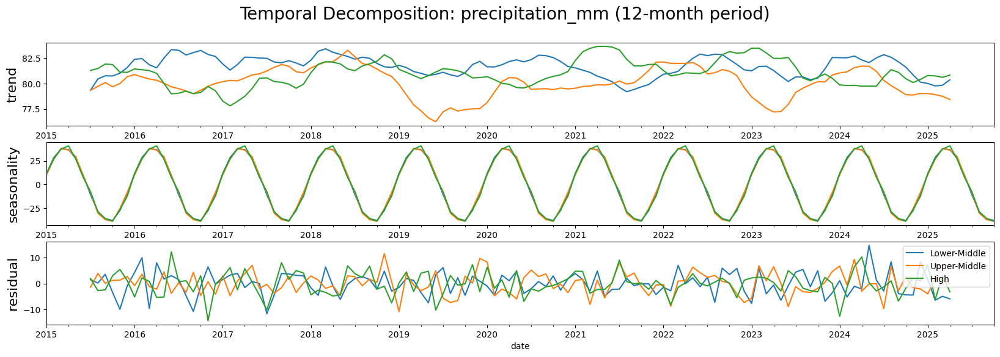

In [ ]:
plot_grouped_seasonal_decompose(df_date_indexed, "income_level", "precipitation_mm", 12)

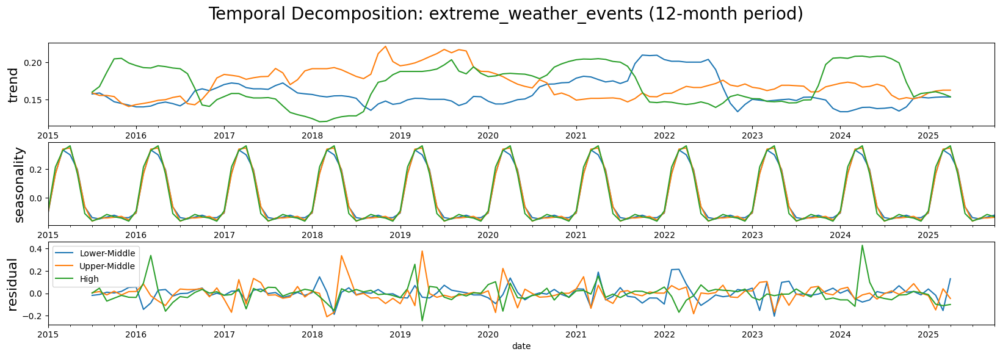

In [ ]:
plot_grouped_seasonal_decompose(df_date_indexed, "income_level", "extreme_weather_events", 12)

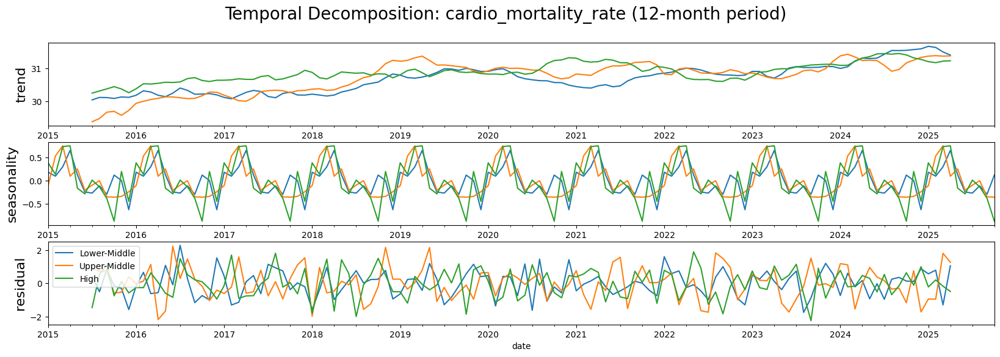

In [ ]:
plot_grouped_seasonal_decompose(df_date_indexed, "income_level", "cardio_mortality_rate", 12)

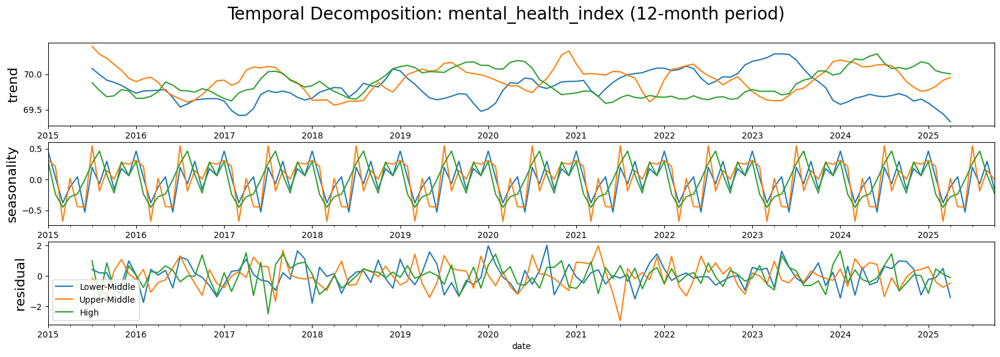

In [ ]:
plot_grouped_seasonal_decompose(df_date_indexed, "income_level", "mental_health_index", 12)

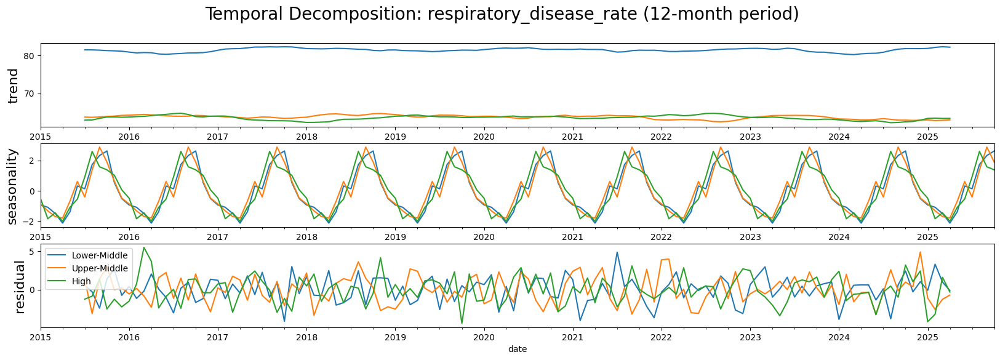

In [ ]:
plot_grouped_seasonal_decompose(df_date_indexed, "income_level", "respiratory_disease_rate", 12)

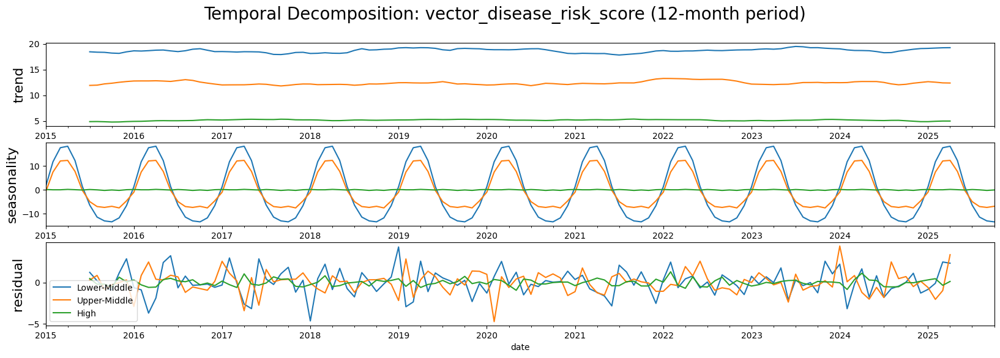

In [ ]:
plot_grouped_seasonal_decompose(df_date_indexed, "income_level", "vector_disease_risk_score", 12)

# 3: Regression Models


## 3.1: Data Preparation


In [ ]:
# Ensure required variables are defined for the modeling section
# (In case cells are run out of order)

# Define target and ignore columns if not already defined
if 'target_cols' not in locals():
    target_cols = [
        'respiratory_disease_rate', 'cardio_mortality_rate', 'vector_disease_risk_score',
        'waterborne_disease_incidents', 'heat_related_admissions', 'mental_health_index'
    ]

if 'ignore_cols' not in locals():
    ignore_cols = ['record_id', 'country_name', 'date', 'year', 'month']

# Create df_date_indexed if not already created
if 'df_date_indexed' not in locals():
    df_date_indexed = data.set_index("date").sort_index()

print("✓ All required variables available")
print(f"  target_cols: {target_cols}")
print(f"  ignore_cols: {ignore_cols}")
print(f"  df_date_indexed shape: {df_date_indexed.shape}")


✓ All required variables available
  target_cols: ['respiratory_disease_rate', 'cardio_mortality_rate', 'vector_disease_risk_score', 'waterborne_disease_incidents', 'heat_related_admissions', 'mental_health_index']
  ignore_cols: ['record_id', 'country_name', 'date', 'year', 'month']
  df_date_indexed shape: (14100, 29)


In [ ]:
df_date_indexed.columns

Index(['record_id', 'country_code', 'country_name', 'region', 'income_level',
       'year', 'month', 'week', 'latitude', 'longitude', 'population_millions',
       'temperature_celsius', 'temp_anomaly_celsius', 'precipitation_mm',
       'heat_wave_days', 'drought_indicator', 'flood_indicator',
       'extreme_weather_events', 'pm25_ugm3', 'air_quality_index',
       'respiratory_disease_rate', 'cardio_mortality_rate',
       'vector_disease_risk_score', 'waterborne_disease_incidents',
       'heat_related_admissions', 'healthcare_access_index',
       'gdp_per_capita_usd', 'mental_health_index', 'food_security_index'],
      dtype='object')

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

def encode_cat_data(data, norminal_cat_cols=['country_code', 'region'], ordinal_cat_cols=['income_level']):
    """
    Encodes the categorical features. One-hot encoding for nominal, integer encoding
    for ordinal. The latter is required to be of type 'category'.
    """
    # Nominal categories
    # Do not use drop_first=True to keep all category columns (for better manual explainability)
    result = pd.get_dummies(data, columns=norminal_cat_cols)

    # Ordinal categories
    for ordinal_cat_col in ordinal_cat_cols:
        result[ordinal_cat_col] = result[ordinal_cat_col].cat.codes
    return result

def split_scale_data_temporal(data, target_cols=None, ignore_cols=None, train_end_year=2022, val_end_year=2023):
    """
    Splits and scales the data using TEMPORAL split (appropriate for time series).
    Train: 2015-2022, Validation: 2023, Test: 2024-2025

    This prevents data leakage from future observations into training data.

    Returns: Tuple with the following:
        1. Scaled training set input
        2. Scaled test set input
        3. Training set output
        4. Test set output
        5. Input column names
        6. Output column names
        7. Scaler object (for inverse transform if needed)
    """
    # Set defaults if not provided
    if target_cols is None:
        target_cols = [
            'respiratory_disease_rate', 'cardio_mortality_rate', 'vector_disease_risk_score',
            'waterborne_disease_incidents', 'heat_related_admissions', 'mental_health_index'
        ]
    if ignore_cols is None:
        ignore_cols = ['record_id', 'country_name', 'date', 'year', 'month']

    feature_cols = data.columns.drop(target_cols).drop(ignore_cols, errors="ignore")

    # Temporal split based on year
    train_mask = data['year'] <= train_end_year
    test_mask = data['year'] > val_end_year  # Test on 2024-2025

    X_train = data.loc[train_mask, feature_cols]
    Y_train = data.loc[train_mask, target_cols]
    X_test = data.loc[test_mask, feature_cols]
    Y_test = data.loc[test_mask, target_cols]

    print(f"Temporal Split: Train ({data.loc[train_mask, 'year'].min()}-{data.loc[train_mask, 'year'].max()}): {len(X_train)} samples")
    print(f"Temporal Split: Test ({data.loc[test_mask, 'year'].min()}-{data.loc[test_mask, 'year'].max()}): {len(X_test)} samples")

    # Only fit scaler on training data to prevent data leakage
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    return X_train_scaled, X_test_scaled, Y_train, Y_test, feature_cols, target_cols, scaler

# Keep the old function for backward compatibility, but mark it as deprecated
def split_scale_data(data, target_cols=None, ignore_cols=None):
    """
    DEPRECATED: Uses random split which causes data leakage in time series.
    Use split_scale_data_temporal() instead.
    """
    # Set defaults if not provided
    if target_cols is None:
        target_cols = [
            'respiratory_disease_rate', 'cardio_mortality_rate', 'vector_disease_risk_score',
            'waterborne_disease_incidents', 'heat_related_admissions', 'mental_health_index'
        ]
    if ignore_cols is None:
        ignore_cols = ['record_id', 'country_name', 'date', 'year', 'month']

    print("WARNING: Using random split. For time series, use split_scale_data_temporal() instead.")
    feature_cols = data.columns.drop(target_cols).drop(ignore_cols, errors="ignore")

    rand_seed = 156
    X_train, X_test, Y_train, Y_test = train_test_split(
        data[feature_cols], data[target_cols], train_size=0.8, random_state=rand_seed
    )

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    return X_train_scaled, X_test_scaled, Y_train, Y_test, feature_cols, target_cols

In [ ]:
# Use temporal split to prevent data leakage (future data in training set)
df_cat_encoded = encode_cat_data(data)
X_train, X_test, Y_train, Y_test, X_cols, Y_cols, scaler = split_scale_data_temporal(df_cat_encoded)

Temporal Split: Train (2015-2022): 10425 samples
Temporal Split: Test (2024-2025): 2350 samples


## 3.2: Linear Regression


In [ ]:
from sklearn import metrics

# Compatibility function for sklearn versions that don't have root_mean_squared_error
def calc_rmse(y_true, y_pred):
    """Calculate root mean squared error (compatible with all sklearn versions)."""
    if hasattr(metrics, 'root_mean_squared_error'):
        return metrics.root_mean_squared_error(y_true, y_pred)
    else:
        return np.sqrt(metrics.mean_squared_error(y_true, y_pred))

def r2_breakdown(actual, predict, target_cols):
    """
    Returns a dataframe breaking down the R-squared and RMSE of a linear model (based on
    its predictions) for each of the specified target variables.
    """
    r2_scores = [metrics.r2_score(actual[:, i], predict[:, i]) for i in range(len(target_cols))]
    rmse_scores = [calc_rmse(actual[:, i], predict[:, i]) for i in range(len(target_cols))]
    result = pd.DataFrame({"Target": target_cols, "R-squared": r2_scores, "RMSE": rmse_scores})
    result.loc["Overall", "R-squared"] = metrics.r2_score(actual, predict)
    result.loc["Overall", "RMSE"] = calc_rmse(actual, predict)
    return result

In [ ]:
from sklearn.linear_model import LinearRegression

model_lin = LinearRegression()
model_lin.fit(X_train, Y_train)

predict_lin_train = model_lin.predict(X_train)
r2_breakdown(Y_train.to_numpy(), predict_lin_train, Y_cols)

,Target,R-squared,RMSE
0,respiratory_disease_rate,0.578745,9.847141
1,cardio_mortality_rate,0.204369,4.993705
2,vector_disease_risk_score,0.551736,11.406454
3,waterborne_disease_incidents,0.426355,5.023351
4,heat_related_admissions,0.806752,4.153837
5,mental_health_index,0.017837,4.972968
Overall,NaN,0.430966,6.732909


In [ ]:
predict_lin = model_lin.predict(X_test)
r2_breakdown(Y_test.to_numpy(), predict_lin, Y_cols)

,Target,R-squared,RMSE
0,respiratory_disease_rate,0.576493,9.968267
1,cardio_mortality_rate,0.171620,5.101530
2,vector_disease_risk_score,0.564494,11.659754
3,waterborne_disease_incidents,0.409241,5.015454
4,heat_related_admissions,0.794276,4.449545
5,mental_health_index,0.013145,5.030557
Overall,NaN,0.421545,6.870851


In [ ]:
# visualizing the predictions
def plot_regression(y_true, y_pred, ax, axis_label=""):
  y_residual = np.abs(y_true-y_pred)
  scatter = ax.scatter(x=y_true, y=y_pred, c=y_residual, cmap="cool", marker="o", s=10, alpha=0.8)
  ax.set_xlabel("Actual %s"%axis_label, fontsize=10); ax.set_ylabel("Predicted %s"%axis_label, fontsize=10);
  R_squared = metrics.r2_score(y_true, y_pred)
  ax.set_title("$R^{2}$ = "+str(round(R_squared, 3)), fontsize=18);
  ax.set_aspect(1)
  cbar = plt.colorbar(scatter)
  cbar.ax.set_ylabel("Residual", rotation=90, fontsize=10)
  ax.plot([np.min(y_true), np.max(y_true)], [np.min(y_true), np.max(y_true)], "r--", alpha=0.75, linewidth=3)

def plot_residuals(Y_test, predictions, target_names=None):
    """
    Plot residuals for predictions vs actual values.

    Args:
        Y_test: Test target values (DataFrame or numpy array)
        predictions: Model predictions (numpy array)
        target_names: List of target column names (extracted from Y_test if not provided)
    """
    # Extract target names if not provided
    if target_names is None:
        if hasattr(Y_test, 'columns'):
            target_names = Y_test.columns.tolist()
        else:
            target_names = [f'Target {i}' for i in range(predictions.shape[1])]

    fig, axs = plt.subplots(2, 3, figsize=(15, 10))
    fig.subplots_adjust(wspace=0.5, hspace=0)
    for i, (y_col, ax) in enumerate(zip(target_names, axs.flat)):
        if hasattr(Y_test, 'iloc'):
            plot_regression(Y_test.iloc[:, i], predictions[:, i], ax, axis_label=y_col)
        else:
            plot_regression(Y_test[:, i], predictions[:, i], ax, axis_label=y_col)

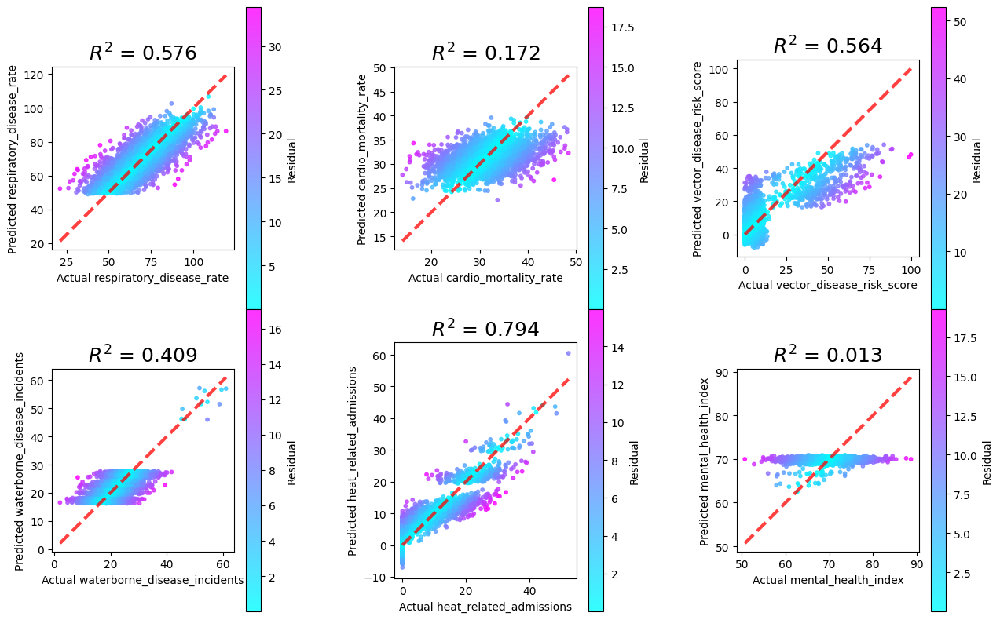

In [ ]:
plot_residuals(Y_test, predict_lin)

## 3.3: Cross-Validation with TimeSeriesSplit

For time series data, we need to use TimeSeriesSplit instead of regular K-Fold cross-validation to prevent data leakage. This ensures we always train on past data and validate on future data.


In [ ]:
from sklearn.model_selection import TimeSeriesSplit, cross_val_score
from sklearn.linear_model import Ridge, Lasso, ElasticNet

def cross_validate_timeseries(X, y, model, n_splits=5, target_col_names=None):
    """
    Perform time series cross-validation and return mean scores.

    Args:
        X: Feature matrix (numpy array)
        y: Target vector (numpy array or DataFrame)
        model: sklearn model
        n_splits: Number of CV splits
        target_col_names: List of target column names (extracted from y if not provided)

    Returns:
        Dictionary with mean and std of R² and negative MSE
    """
    tscv = TimeSeriesSplit(n_splits=n_splits)

    # Convert y to numpy if DataFrame and extract column names
    if hasattr(y, 'to_numpy'):
        if target_col_names is None and hasattr(y, 'columns'):
            target_col_names = y.columns.tolist()
        y_np = y.to_numpy()
    else:
        y_np = y

    # For multi-output, we need to do CV per target
    if len(y_np.shape) > 1 and y_np.shape[1] > 1:
        if target_col_names is None:
            target_col_names = [f'Target_{i}' for i in range(y_np.shape[1])]
        results = {}
        for i, col in enumerate(target_col_names):
            r2_scores = cross_val_score(model, X, y_np[:, i], cv=tscv, scoring='r2')
            results[col] = {
                'mean_r2': r2_scores.mean(),
                'std_r2': r2_scores.std()
            }
        return pd.DataFrame(results).T
    else:
        r2_scores = cross_val_score(model, X, y_np.ravel(), cv=tscv, scoring='r2')
        return {'mean_r2': r2_scores.mean(), 'std_r2': r2_scores.std()}

# Perform cross-validation for linear regression on each target
print("Cross-Validation Results (TimeSeriesSplit, 5 folds):")
print("=" * 60)
cv_results = cross_validate_timeseries(X_train, Y_train, LinearRegression(), target_col_names=Y_cols)
cv_results


Cross-Validation Results (TimeSeriesSplit, 5 folds):


,mean_r2,std_r2
respiratory_disease_rate,0.481085,0.083121
cardio_mortality_rate,0.100108,0.142353
vector_disease_risk_score,0.204466,0.242048
waterborne_disease_incidents,0.211991,0.070633
heat_related_admissions,0.056165,0.440389
mental_health_index,-0.062190,0.130678


## 3.4: Regularized Regression Models

With many correlated features (especially 25+ one-hot encoded country columns), regularization helps prevent overfitting and can improve generalization:

-   **Ridge (L2)**: Shrinks coefficients, good for multicollinearity
-   **Lasso (L1)**: Can zero out coefficients, performs feature selection
-   **ElasticNet**: Combination of L1 and L2


In [ ]:
from sklearn.multioutput import MultiOutputRegressor

def compare_regularized_models(X_train, X_test, Y_train, Y_test, alphas=[0.01, 0.1, 1.0, 10.0]):
    """
    Compare Ridge, Lasso, and ElasticNet with different regularization strengths.
    """
    results = []

    models_config = [
        ('Linear', LinearRegression()),
    ]

    # Add regularized models with different alphas
    for alpha in alphas:
        models_config.extend([
            (f'Ridge(α={alpha})', MultiOutputRegressor(Ridge(alpha=alpha))),
            (f'Lasso(α={alpha})', MultiOutputRegressor(Lasso(alpha=alpha, max_iter=5000))),
            (f'ElasticNet(α={alpha})', MultiOutputRegressor(ElasticNet(alpha=alpha, max_iter=5000))),
        ])

    for name, model in models_config:
        model.fit(X_train, Y_train)

        train_pred = model.predict(X_train)
        test_pred = model.predict(X_test)

        train_r2 = metrics.r2_score(Y_train, train_pred)
        test_r2 = metrics.r2_score(Y_test, test_pred)
        test_rmse = calc_rmse(Y_test, test_pred)

        results.append({
            'Model': name,
            'Train R²': train_r2,
            'Test R²': test_r2,
            'Test RMSE': test_rmse
        })

    return pd.DataFrame(results)

# Compare models
print("Comparing Linear vs Regularized Regression Models:")
print("=" * 60)
regularization_comparison = compare_regularized_models(X_train, X_test, Y_train, Y_test)
regularization_comparison.sort_values('Test R²', ascending=False)


Comparing Linear vs Regularized Regression Models:


,Model,Train R²,Test R²,Test RMSE
2,Lasso(α=0.01),0.430726,0.422543,6.861360
3,ElasticNet(α=0.01),0.430652,0.422150,6.864611
10,Ridge(α=10.0),0.430954,0.421875,6.867006
7,Ridge(α=1.0),0.430966,0.421595,6.870270
4,Ridge(α=0.1),0.430966,0.421550,6.870790
1,Ridge(α=0.01),0.430966,0.421545,6.870845
0,Linear,0.430966,0.421545,6.870851
5,Lasso(α=0.1),0.426552,0.419939,6.889401
6,ElasticNet(α=0.1),0.423675,0.415910,6.936500
8,Lasso(α=1.0),0.379856,0.372264,7.280018


Despite a Lasso model (α = 1.0) performing slightly better above, a Ridge model (α = 1.0) was chosen because we believed it would be more stable and reliable when many features are related to each other. Lasso can drop variables entirely, which could make results less consistent, while Ridge keeps all features but controls their influence. The reason we chose α = 1.0 was as we were worried that the slightly more experimentally performant α = 10.0 would have too high of a learning rate when trying to generalize, causing it to be inflexible (i.e. lower variance, increase bias).

In [ ]:
# Train Ridge model with best alpha and show per-target breakdown
best_alpha = 1.0  # Adjust based on results above
model_ridge = MultiOutputRegressor(Ridge(alpha=best_alpha))
model_ridge.fit(X_train, Y_train)

print(f"Ridge Regression (α={best_alpha}) - Per-Target Breakdown:")
print("=" * 60)
r2_breakdown(Y_test.to_numpy(), model_ridge.predict(X_test), Y_cols)


Ridge Regression (α=1.0) - Per-Target Breakdown:


,Target,R-squared,RMSE
0,respiratory_disease_rate,0.576530,9.967828
1,cardio_mortality_rate,0.171620,5.101531
2,vector_disease_risk_score,0.564728,11.656618
3,waterborne_disease_incidents,0.409244,5.015440
4,heat_related_admissions,0.794256,4.449757
5,mental_health_index,0.013189,5.030446
Overall,NaN,0.421595,6.870270


In [ ]:
coef_lin = pd.DataFrame(model_lin.coef_, columns=X_cols, index=Y_cols).T
coef_lin

,respiratory_disease_rate,cardio_mortality_rate,vector_disease_risk_score,waterborne_disease_incidents,heat_related_admissions,mental_health_index
income_level,-0.450599,0.053998,-1.431522,-0.829250,1.928035,0.271563
week,-0.271317,-0.063652,-0.029131,-0.073259,-0.149027,-0.104469
latitude,-0.182245,0.020665,-0.187021,-0.167405,1.177520,0.063665
longitude,0.017757,-0.002783,-0.347997,0.234373,-0.560294,-0.036528
population_millions,0.064084,-0.026604,0.107357,0.003357,-0.096874,-0.014241
temperature_celsius,0.176019,-0.158424,11.010245,-0.127288,10.630105,-0.189046
temp_anomaly_celsius,-0.148534,2.461655,-0.005539,-0.016539,-0.006671,-0.056719
precipitation_mm,-0.291045,0.009919,0.791785,-0.011235,-0.066497,0.001670
heat_wave_days,0.361718,0.299499,0.282592,-0.148746,2.353484,-0.054293
drought_indicator,0.005378,-0.075939,-0.071640,-0.054806,-0.393865,-0.295226


## 3.5: Comparison: Original vs Engineered Features

Let's compare model performance using the original features vs the engineered features (with rolling averages and interactions).


In [ ]:
# Prepare data with engineered features
df_engineered_encoded = encode_cat_data(data_engineered)
X_train_eng, X_test_eng, Y_train_eng, Y_test_eng, X_cols_eng, Y_cols_eng, scaler_eng = split_scale_data_temporal(df_engineered_encoded)

# Train Ridge model on engineered features
model_ridge_eng = MultiOutputRegressor(Ridge(alpha=1.0))
model_ridge_eng.fit(X_train_eng, Y_train_eng)

# Compare results
print("Model Comparison: Original Features vs Engineered Features")
print("=" * 70)
print("\nOriginal Features (Ridge, α=1.0):")
r2_original = r2_breakdown(Y_test.to_numpy(), model_ridge.predict(X_test), Y_cols)
print(r2_original)

print("\nEngineered Features (Ridge, α=1.0):")
r2_engineered = r2_breakdown(Y_test_eng.to_numpy(), model_ridge_eng.predict(X_test_eng), Y_cols_eng)
print(r2_engineered)

# Summary comparison
comparison = pd.DataFrame({
    'Original R²': r2_original['R-squared'].values,
    'Engineered R²': r2_engineered['R-squared'].values,
    'Improvement': r2_engineered['R-squared'].values - r2_original['R-squared'].values
}, index=list(Y_cols) + ['Overall'])
print("\n" + "=" * 70)
print("Summary Comparison:")
comparison


Temporal Split: Train (2015-2022): 10425 samples
Temporal Split: Test (2024-2025): 2350 samples
Model Comparison: Original Features vs Engineered Features

Original Features (Ridge, α=1.0):
                               Target  R-squared       RMSE
0            respiratory_disease_rate   0.576530   9.967828
1               cardio_mortality_rate   0.171620   5.101531
2           vector_disease_risk_score   0.564728  11.656618
3        waterborne_disease_incidents   0.409244   5.015440
4             heat_related_admissions   0.794256   4.449757
5                 mental_health_index   0.013189   5.030446
Overall                           NaN   0.421595   6.870270

Engineered Features (Ridge, α=1.0):
                               Target  R-squared       RMSE
0            respiratory_disease_rate   0.576217   9.971513
1               cardio_mortality_rate   0.170287   5.105632
2           vector_disease_risk_score   0.660144  10.300061
3        waterborne_disease_incidents   0.408820   5.

,Original R²,Engineered R²,Improvement
respiratory_disease_rate,0.576530,0.576217,-0.000313
cardio_mortality_rate,0.171620,0.170287,-0.001332
vector_disease_risk_score,0.564728,0.660144,0.095416
waterborne_disease_incidents,0.409244,0.408820,-0.000424
heat_related_admissions,0.794256,0.794106,-0.000150
mental_health_index,0.013189,0.010133,-0.003055
Overall,0.421595,0.436618,0.015023


## 3.6: Feature Selection


### 3.6.1: Filter Method - Univariate Feature Selection

The goal in this section is to reduce the number of features used to predict each target health outcome. The hope is that there are actually features that are unneeded and actually bogging down our model by making it learn what is effectively just noise for each target variable.


In [ ]:
from sklearn.feature_selection import SelectKBest, f_regression

def univariate_feature_selection(df, X, y):
    """
    Uses f-test for regression to determine the statistical signficance of each
    features in X to the targets in y.

    Accepts:
        df  Dataframe
        X   feature columns in df
        y   target columns in df

    Returns DataFrame where the rows list the feature columns in descending order
    of statistical significance to each target. Columns are multi-index. Top
    layer is each target variable, and second layer has:
        index: column id of that feature in original df
        score: f-statistic (how many times better feature is at predicting target than random model)
        p-values: statistical significance (lower better), chance got score by random chance
    """
    ranked_features = []

    for i, target_col in enumerate(y):
        model_kbest = SelectKBest(score_func=f_regression)
        selected_features = model_kbest.fit(df[X], df[y[i]])

        # Sort so the most statistically significant features for each target are at top
        ranked_features.append(
            pd.DataFrame({
                "feature": X,
                "score": selected_features.scores_,
                "p-values": selected_features.pvalues_
            }).sort_values(by="p-values", ascending=True).reset_index()
        )

    return pd.concat(ranked_features, axis=1, keys=y)

In [ ]:
f_test_results = univariate_feature_selection(df_cat_encoded, X_cols, Y_cols)
f_test_results.head(10)

respiratory_disease_rate                                         \
                     index                  feature         score   
0                        0             income_level   4765.433728   
1                       13        air_quality_index  16722.739623   
2                       14  healthcare_access_index   4623.146955   
3                       15       gdp_per_capita_usd   2341.960945   
4                       12                pm25_ugm3  19158.990103   
5                       16      food_security_index   2284.667812   
6                       48        region_South Asia   1159.254861   
7                        3                longitude   1003.929713   
8                        5      temperature_celsius    798.653007   
9                       44            region_Europe    633.502291   

                 cardio_mortality_rate                                       \
        p-values                 index                 feature        score   
0   0.000000e+00                     6    temp_anomaly_celsius  3288.965018   
1   0.000000e+00                     8          heat_wave_days   138.345203   
2   0.000000e+00                    11  extreme_weather_events   122.433975   
3   0.000000e+00                     1                    week    19.533259   
4   0.000000e+00                     7        precipitation_mm    11.107126   
5   0.000000e+00                    13       air_quality_index     6.472494   
6  2.969890e-244                    12               pm25_ugm3     5.952982   
7  6.716542e-213                    15      gdp_per_capita_usd     4.813032   
8  5.904456e-171                    49   region_Southeast Asia     4.670660   
9  8.867748e-137                    20        country_code_BRA     3.985150   

                vector_disease_risk_score                           ...  \
       p-values                     index                  feature  ...   
0  0.000000e+00                         0             income_level  ...   
1  8.622827e-32                         5      temperature_celsius  ...   
2  2.426398e-28                        15       gdp_per_capita_usd  ...   
3  9.960156e-06                        14  healthcare_access_index  ...   
4  8.621797e-04                        33         country_code_KEN  ...   
5  1.096625e-02                        29         country_code_IDN  ...   
6  1.470465e-02                         1                     week  ...   
7  2.826157e-02                        49    region_Southeast Asia  ...   
8  3.069892e-02                         7         precipitation_mm  ...   
9  4.592222e-02                        23         country_code_COL  ...   

  waterborne_disease_incidents                heat_related_admissions  \
                         score       p-values                   index   
0                  5502.301773   0.000000e+00                       1   
1                  2187.840512   0.000000e+00                       5   
2                  6023.408992   0.000000e+00                       7   
3                  4064.548397   0.000000e+00                       8   
4                  1912.960965   0.000000e+00                      11   
5                  1778.653950   0.000000e+00                      12   
6                  1953.260622   0.000000e+00                      13   
7                  3167.190843   0.000000e+00                      10   
8                  1629.427790   0.000000e+00                       9   
9                   841.887658  7.732246e-180                      16   

                                                      mental_health_index  \
                  feature         score      p-values               index   
0                    week   7328.611463  0.000000e+00                  10   
1     temperature_celsius   2939.437236  0.000000e+00                  11   
2        precipitation_mm   4832.148079  0.000000e+00                   9   
3          heat_wave_days  13501.043088  0.000000e+00        

In [ ]:
def filter_significant_inputs(target_col, threshold=0.05):
    sub_df = f_test_results[target_col]
    return sub_df[sub_df["p-values"] < threshold]

def summarize_significant_predictors(threshold=0.05):
    counts = []
    predictors = []
    pred_idx = []

    for i in Y_cols:
        significant_inputs = filter_significant_inputs(i, threshold=threshold)
        counts.append(len(significant_inputs))
        predictors.append(significant_inputs["feature"].tolist())
        pred_idx.append(significant_inputs["index"].tolist())

    return pd.DataFrame({"target": Y_cols, "num_sig_predictors": counts, "predictors": predictors, "pred_idx": pred_idx})

significant_predictors = summarize_significant_predictors()
significant_predictors

,target,num_sig_predictors,predictors,pred_idx
0,respiratory_disease_rate,46,"[income_level, air_quality_index, healthcare_a...","[0, 13, 14, 15, 12, 16, 48, 3, 5, 44, 49, 42, ..."
1,cardio_mortality_rate,10,"[temp_anomaly_celsius, heat_wave_days, extreme...","[6, 8, 11, 1, 7, 13, 12, 15, 49, 20]"
2,vector_disease_risk_score,48,"[income_level, temperature_celsius, gdp_per_ca...","[0, 5, 15, 14, 33, 29, 1, 49, 7, 23, 2, 16, 44..."
3,waterborne_disease_incidents,45,"[income_level, temperature_celsius, healthcare...","[0, 5, 14, 15, 12, 13, 10, 16, 44, 49, 2, 48, ..."
4,heat_related_admissions,10,"[week, temperature_celsius, precipitation_mm, ...","[1, 5, 7, 8, 11, 12, 13, 10, 9, 16]"
5,mental_health_index,7,"[flood_indicator, extreme_weather_events, drou...","[10, 11, 9, 8, 16, 5, 39]"


### 3.6.2: Retraining with only selected features

The R-squared did not really improve for most of the health outcomes. In several the performance was worse. For some, such as cardio_mortality_rate and mental_health_index, it improved slightly. The R-squared for those are still very low after doing the UFS though. Overall, it does not seem to have improved things very much.


In [ ]:
def train_linear_model_after_ufs(row):
    model = LinearRegression()
    model.fit(X_train[:, row["pred_idx"]], Y_train[row["target"]])
    return model

significant_predictors["model_linear"] = significant_predictors.apply(train_linear_model_after_ufs, axis=1)

In [ ]:
def pred_ufs(row, input_data):
    filtered_input = input_data[:, row["pred_idx"]]
    return pd.Series(row["model_linear"].predict(filtered_input))


r2_breakdown(
    Y_train.to_numpy(),
    significant_predictors.apply(pred_ufs, args=(X_train,), axis=1).T.to_numpy(),
    Y_cols
)

,Target,R-squared,RMSE
0,respiratory_disease_rate,0.576834,9.869452
1,cardio_mortality_rate,0.203683,4.995855
2,vector_disease_risk_score,0.551736,11.406456
3,waterborne_disease_incidents,0.426349,5.023378
4,heat_related_admissions,0.702525,5.153671
5,mental_health_index,0.014565,4.981246
Overall,NaN,0.412615,6.905010


In [ ]:
r2_breakdown(
    Y_test.to_numpy(),
    significant_predictors.apply(pred_ufs, args=(X_test,), axis=1).T.to_numpy(),
    Y_cols
)

,Target,R-squared,RMSE
0,respiratory_disease_rate,0.572101,10.019818
1,cardio_mortality_rate,0.171987,5.100399
2,vector_disease_risk_score,0.564501,11.659657
3,waterborne_disease_incidents,0.409404,5.014760
4,heat_related_admissions,0.683640,5.517776
5,mental_health_index,0.017679,5.018989
Overall,NaN,0.403219,7.055233


## 3.7: Linear Model With Data With Box-Cox Transformation Applied


There does not seem to be any appreciable improvement in R-squared of the models when using the box-cox transformed data. The root mean-squared error is substantially lower though.


In [ ]:
def train_analyze_model(X_train, X_test, Y_train, Y_test, model):
    model.fit(X_train, Y_train)

    # Get target column names from Y_train if it's a DataFrame
    target_col_names = Y_train.columns.tolist() if hasattr(Y_train, 'columns') else None
    if target_col_names is None:
        # Fallback to default target names
        target_col_names = [
            'respiratory_disease_rate', 'cardio_mortality_rate', 'vector_disease_risk_score',
            'waterborne_disease_incidents', 'heat_related_admissions', 'mental_health_index'
        ]

    r2_train = r2_breakdown(Y_train.to_numpy(), model.predict(X_train), target_col_names)
    r2_test = r2_breakdown(Y_test.to_numpy(), model.predict(X_test), target_col_names)

    return r2_train, r2_test

def prepare_train_analyze_model(data, model, use_temporal_split=True):
    """
    Encodes categorical data, splits into train/test, scales, trains model, and evaluates.

    Args:
        data: DataFrame with features and targets
        model: sklearn model instance
        use_temporal_split: If True, use temporal split (recommended for time series)
    """
    df_cat_encoded = encode_cat_data(data)

    if use_temporal_split:
        X_train, X_test, Y_train, Y_test, X_cols, Y_cols, _ = split_scale_data_temporal(df_cat_encoded)
    else:
        X_train, X_test, Y_train, Y_test, X_cols, Y_cols = split_scale_data(df_cat_encoded)

    r2_train, r2_test = train_analyze_model(X_train, X_test, Y_train, Y_test, model)

    return model, r2_train, r2_test, X_train, X_test, Y_train, Y_test, X_cols, Y_cols

def prepare_train_analyze_linear_model(data):
    model = LinearRegression()
    return prepare_train_analyze_model(data, model)

In [ ]:
model_lin_bc, r2_train_lin_bc, r2_test_lin_bc, _, X_test_bc, _, Y_test_bc, _, _ = prepare_train_analyze_linear_model(transformed_data)
pd.concat([r2_train_lin_bc, r2_test_lin_bc], axis=1, keys=["train", "test"])

Temporal Split: Train (2015-2022): 10425 samples
Temporal Split: Test (2024-2025): 2350 samples


train                       \
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.568767   9.963080   
1               cardio_mortality_rate  0.203596   4.996128   
2           vector_disease_risk_score  0.544173  11.502274   
3        waterborne_disease_incidents  0.426499   5.022720   
4             heat_related_admissions  0.776426   4.467881   
5                 mental_health_index  0.017897   4.972818   
Overall                           NaN  0.422893   6.820817   

                                 test                       
                               Target R-squared       RMSE  
0            respiratory_disease_rate  0.566609  10.083921  
1               cardio_mortality_rate  0.169026   5.109510  
2           vector_disease_risk_score  0.560687  11.710602  
3        waterborne_disease_incidents  0.408546   5.018404  
4             heat_related_admissions  0.769158   4.713363  
5                 mental_health_index  0.015299   5.025063  
Overall                           NaN  0.414887   6.943477

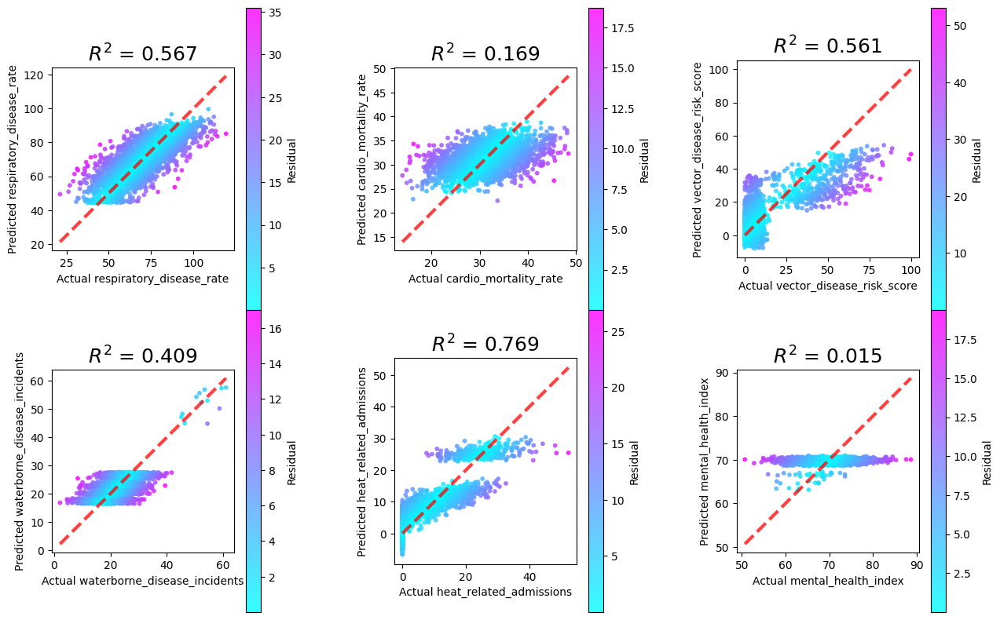

In [ ]:
plot_residuals(Y_test_bc, model_lin_bc.predict(X_test_bc))

## 3.8: Linear Model Using Original Data, One Model Per Income Level


There does not seem to be any appreciable improvement in R-squared from breaking down the data by income level.  One thing to note is that for the High income level, the R-squared for vector_disease_risk_score is effectively zero while the RMSE is actually lower than the other income levels.  This seems to be due to the effectively zero variance of that health indicator within the High income level.  It seems in this case a constant average might have been a better approach.


In [ ]:
income_levels = data["income_level"].unique()
income_level_results = []
for income_level in income_levels:
    model, r2_train, r2_test, _, _, _, _, _, _ = prepare_train_analyze_linear_model(data[data["income_level"] == income_level])
    income_level_result = pd.concat([r2_train, r2_test], axis=1, keys=["train", "test"])
    income_level_results.append(income_level_result)
pd.concat(income_level_results, axis=1, keys=income_levels)

Temporal Split: Train (2015-2022): 3753 samples
Temporal Split: Test (2024-2025): 846 samples
Temporal Split: Train (2015-2022): 3753 samples
Temporal Split: Test (2024-2025): 846 samples
Temporal Split: Train (2015-2022): 2919 samples
Temporal Split: Test (2024-2025): 658 samples


High                      \
                                train                       
                               Target R-squared      RMSE   
0            respiratory_disease_rate  0.392658  9.795115   
1               cardio_mortality_rate  0.207017  5.026481   
2           vector_disease_risk_score  0.011562  3.214780   
3        waterborne_disease_incidents  0.167324  5.011590   
4             heat_related_admissions  0.811628  4.108109   
5                 mental_health_index  0.019546  5.037855   
Overall                           NaN  0.268289  5.365655   

                                                           \
                                 test                       
                               Target R-squared      RMSE   
0            respiratory_disease_rate  0.323230  9.972892   
1               cardio_mortality_rate  0.173020  5.169112   
2           vector_disease_risk_score -0.014565  3.289625   
3        waterborne_disease_incidents  0.131752  5.052755   
4             heat_related_admissions  0.807205  4.369013   
5                 mental_health_index  0.008926  5.105330   
Overall                           NaN  0.238261  5.493121   

                         Lower-Middle                       \
                                train                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.385048  10.026707   
1               cardio_mortality_rate  0.204063   5.018748   
2           vector_disease_risk_score  0.653130  13.015892   
3        waterborne_disease_incidents  0.225144   5.003810   
4             heat_related_admissions  0.804409   4.139265   
5                 mental_health_index  0.022090   4.981399   
Overall                           NaN  0.382314   7.030970   

                                                            \
                                 test                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.349414  10.171167   
1               cardio_mortality_rate  0.217083   4.920206   
2           vector_disease_risk_score  0.661939  13.206227   
3        waterborne_disease_incidents  0.207133   4.831853   
4             heat_related_admissions  0.778517   4.545876   
5                 mental_health_index  0.000482   5.060587   
Overall                           NaN  0.369095   7.122653   

                         Upper-Middle                       \
                                train                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.376448   9.625039   
1               cardio_mortality_rate  0.205037   4.903142   
2           vector_disease_risk_score  0.512816  11.687881   
3        waterborne_disease_incidents  0.227530   5.041595   
4             heat_related_admissions  0.804638   4.217132   
5                 mental_health_index  0.017354   4.856762   
Overall                           NaN  0.357304   6.721925   

                                                            
                                 test                       
                               Target R-squared       RMSE  
0            respiratory_disease_rate  0.407799   9.773429  
1               cardio_mortality_rate  0.101429   5.269833  
2           vector_disease_risk_score  0.542517  11.652296  
3        waterborne_disease_incidents  0.167271   5.245170  
4             heat_related_admissions  0.793501   4.460074  
5                 mental_health_index  0.011998   4.920407  
Overall                           NaN  0.337419   6.886868

## 3.9: Linear Model With Lagged Variables

Health outcomes don’t always respond immediately to climate events. For example, floods can lead to waterborne disease 1–3 weeks later. Including lagged features can help correct the timing mismatch between the climate event cause and the health impact effect.


In [ ]:
def model_multiple_lags(model_class, data, lags, cols_to_lag, group_col="country_code"):
    """
    Creates lagged features for time series modeling. Lagging features helps capture
    delayed effects (e.g., floods leading to waterborne disease 1-3 weeks later).

    Accepts:
        model_class     Class to instantiate for each lag (e.g., LinearRegression)
        data            Original dataframe (must have 'date' column for temporal split)
        lags            Iterable containing the number of lags to do
        cols_to_lag     The columns to lag (shift forward in time so older values line up with later dates)
        group_col       Name of column to group the data before shifting (e.g. so each country is shifted individually)

    Returns:
        models          List of trained models (one per lag)
        r2_summary      DataFrame with R² and RMSE for each lag
        X_trains        List of training feature arrays
        X_tests         List of test feature arrays
        Y_trains        List of training target DataFrames
        Y_tests         List of test target DataFrames
    """
    lag_results = []
    models = []
    X_trains = []
    X_tests = []
    Y_trains = []
    Y_tests = []

    for lag in lags:
        df_lagged = data.copy()
        # Reset index if date is the index (needed for temporal split)
        if 'date' not in df_lagged.columns and df_lagged.index.name == 'date':
            df_lagged = df_lagged.reset_index()

        df_lagged.loc[:, cols_to_lag] = df_lagged.groupby(group_col, observed=True)[cols_to_lag].shift(lag)
        df_lagged.dropna(subset=cols_to_lag, inplace=True)

        model = model_class()
        model, r2_train, r2_test, X_train, X_test, Y_train, Y_test, _, _  = prepare_train_analyze_model(df_lagged, model)

        lag_result = pd.concat([r2_train, r2_test], axis=1, keys=["train", "test"])
        lag_results.append(lag_result)

        # FIX: Use correct variable names (was using X_trains_lag instead of X_trains)
        models.append(model)
        X_trains.append(X_train)
        X_tests.append(X_test)
        Y_trains.append(Y_train)
        Y_tests.append(Y_test)

    r2_summary = pd.concat(lag_results, axis=1, keys=lags)

    return models, r2_summary, X_trains, X_tests, Y_trains, Y_tests

In [ ]:
lag_weeks = [1, 2, 3]

# Define target columns to lag (these are the health outcome variables)
cols_to_lag = [
    'respiratory_disease_rate', 'cardio_mortality_rate', 'vector_disease_risk_score',
    'waterborne_disease_incidents', 'heat_related_admissions', 'mental_health_index'
]

models_lag, r2_summary_lag, X_trains_lag, X_tests_lag, Y_trains_lag, Y_tests_lag = model_multiple_lags(
    LinearRegression, df_date_indexed, lag_weeks, cols_to_lag
)
r2_summary_lag

Temporal Split: Train (2015-2022): 10400 samples
Temporal Split: Test (2024-2025): 2350 samples
Temporal Split: Train (2015-2022): 10375 samples
Temporal Split: Test (2024-2025): 2350 samples
Temporal Split: Train (2015-2022): 10350 samples
Temporal Split: Test (2024-2025): 2350 samples


1                       \
                                train                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.325307  12.464988   
1               cardio_mortality_rate  0.005266   5.585401   
2           vector_disease_risk_score  0.523765  11.762759   
3        waterborne_disease_incidents  0.306854   5.524001   
4             heat_related_admissions  0.502080   6.672555   
5                 mental_health_index  0.004443   5.002973   
Overall                           NaN  0.277952   7.835446   

                                                            \
                                 test                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.340285  12.418618   
1               cardio_mortality_rate -0.010480   5.639026   
2           vector_disease_risk_score  0.533652  12.090304   
3        waterborne_disease_incidents  0.301921   5.453068   
4             heat_related_admissions  0.505692   6.892257   
5                 mental_health_index -0.002976   5.078199   
Overall                           NaN  0.278016   7.928579   

                                    2                       \
                                train                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.325706  12.463272   
1               cardio_mortality_rate  0.004082   5.586619   
2           vector_disease_risk_score  0.517769  11.845277   
3        waterborne_disease_incidents  0.306453   5.528569   
4             heat_related_admissions  0.478213   6.836243   
5                 mental_health_index  0.004451   5.004582   
Overall                           NaN  0.272779   7.877427   

                                                            \
                                 test                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.339339  12.457853   
1               cardio_mortality_rate -0.012773   5.652301   
2           vector_disease_risk_score  0.535986  12.091292   
3        waterborne_disease_incidents  0.304392   5.454947   
4             heat_related_admissions  0.471283   7.121891   
5                 mental_health_index -0.005562   5.067373   
Overall                           NaN  0.272111   7.974276   

                                    3                       \
                                train                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.326243  12.454374   
1               cardio_mortality_rate  0.004252   5.584783   
2           vector_disease_risk_score  0.507782  11.975645   
3        waterborne_disease_incidents  0.307212   5.527610   
4             heat_related_admissions  0.435204   7.117008   
5                 mental_health_index  0.004415   5.001698   
Overall                           NaN  0.264185   7.943520   

                                                            
                                 test                       
                               Target R-squared       RMSE  
0            respiratory_disease_rate  0.339180  12.438634  
1               cardio_mortality_rate -0.011275   5.648560  
2           vector_disease_risk_score  0.533561  12.134331  
3        waterborne_disease_incidents  0.301331   5.451635  
4             heat_related_admissions  0.454981   7.227683  
5                 mental_health_index -0.003356   5.070591  
Overall                           NaN  0.269070   7.995239

### 3.9.1: Plotting Lag = 1 Week


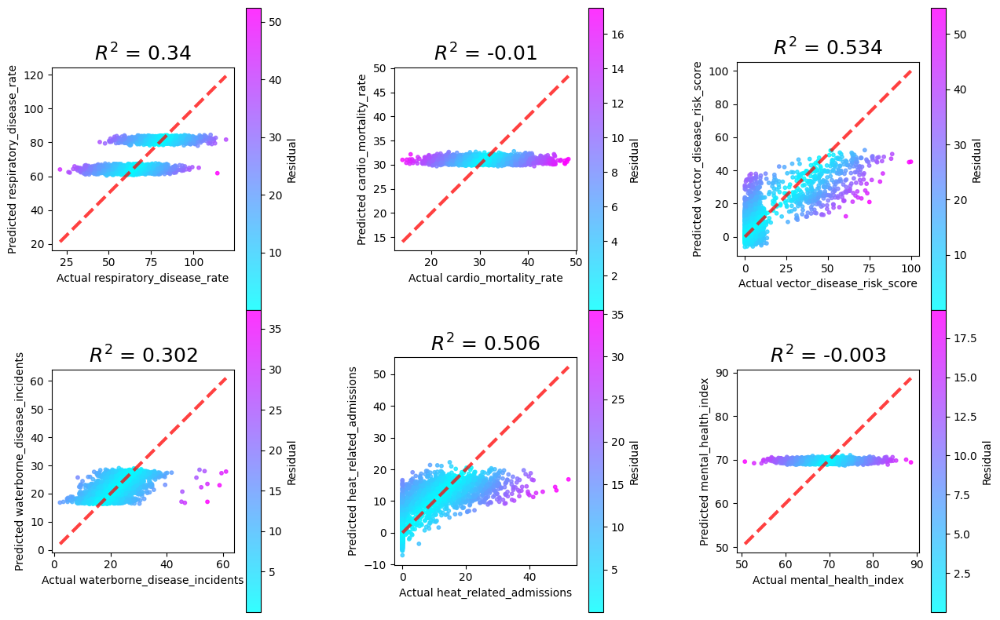

In [ ]:
plot_residuals(Y_tests_lag[0], models_lag[0].predict(X_tests_lag[0]))

### 3.9.2: Plotting Lag = 2 Weeks


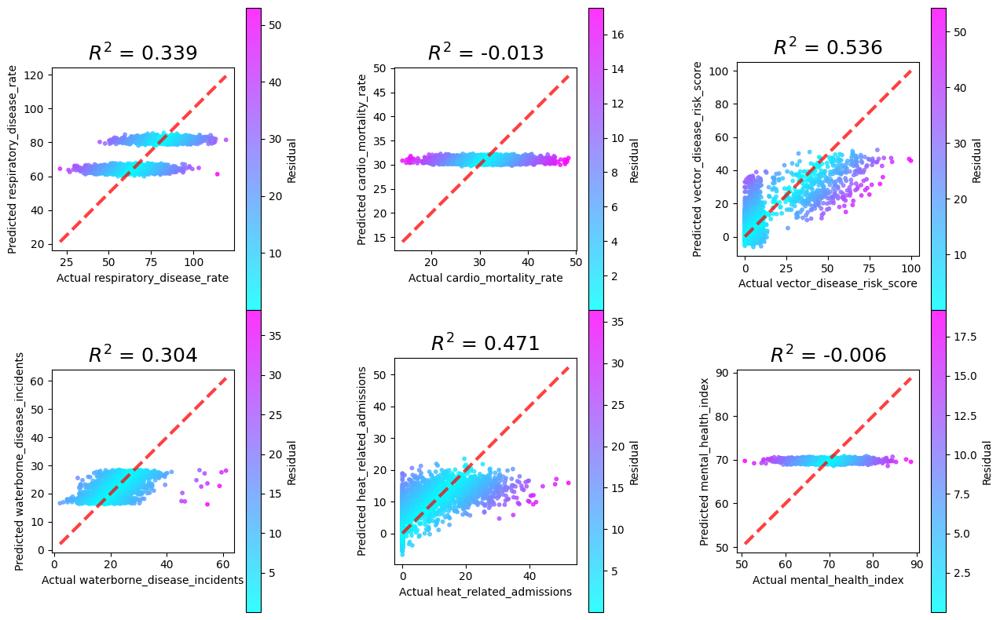

In [ ]:
plot_residuals(Y_tests_lag[1], models_lag[1].predict(X_tests_lag[1]))

### 3.9.3: Plotting Lag = 3 Weeks


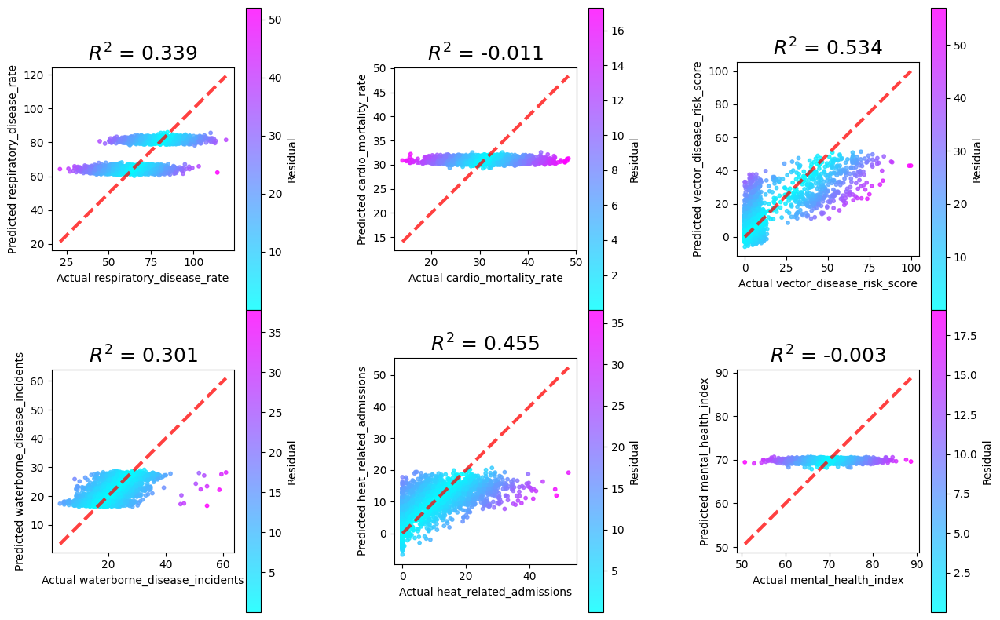

In [ ]:
plot_residuals(Y_tests_lag[2], models_lag[2].predict(X_tests_lag[2]))

## 3.10: Tree-based Regression


In [ ]:
from sklearn.multioutput import MultiOutputRegressor
from sklearn.ensemble import RandomForestRegressor

def init_multi_output_random_forest(n_estimators=100, random_state=156, max_features=100):
    """
    Instantiates a random forest regression model that handles multiple outputs separately.
    Does not train or evaluate it.
    """
    model = RandomForestRegressor(n_estimators=n_estimators, random_state=random_state, max_features=max_features)
    return MultiOutputRegressor(model)

def prepare_train_analyze_random_forest_model(data, n_estimators=100, random_state=156, max_features=100):
    model = init_multi_output_random_forest(n_estimators=n_estimators, random_state=random_state, max_features=max_features)
    return prepare_train_analyze_model(data, model)

# Not using this function since it recreates the data split, when we can just reuse the sets for the original linear model
# model_rf, r2_train_rf, r2_test_rf, X_train_rf, X_test_rf, Y_train_rf, Y_test_rf, X_cols_rf, Y_cols_rf = prepare_train_analyze_random_forest_model(data)

model_rf = init_multi_output_random_forest()
r2_train_rf, r2_test_rf = train_analyze_model(X_train, X_test, Y_train, Y_test, model_rf)
pd.concat([r2_train_rf, r2_test_rf], axis=1, keys=["train", "test"])

train                      \
                               Target R-squared      RMSE   
0            respiratory_disease_rate  0.937100  3.805062   
1               cardio_mortality_rate  0.880867  1.932339   
2           vector_disease_risk_score  0.987701  1.889414   
3        waterborne_disease_incidents  0.914846  1.935414   
4             heat_related_admissions  0.974759  1.501216   
5                 mental_health_index  0.856493  1.900905   
Overall                           NaN  0.925294  2.160725   

                                 test                       
                               Target R-squared       RMSE  
0            respiratory_disease_rate  0.552411  10.247758  
1               cardio_mortality_rate  0.125681   5.241077  
2           vector_disease_risk_score  0.912342   5.231044  
3        waterborne_disease_incidents  0.376808   5.151287  
4             heat_related_admissions  0.801629   4.369303  
5                 mental_health_index -0.021574   5.118283  
Overall                           NaN  0.457883   5.893125

In [ ]:
feature_importance_rf = pd.DataFrame([regressor.feature_importances_ for regressor in model_rf.estimators_], index=Y_cols, columns=X_cols).T
feature_importance_rf

,respiratory_disease_rate,cardio_mortality_rate,vector_disease_risk_score,waterborne_disease_incidents,heat_related_admissions,mental_health_index
income_level,0.000494,0.001030,0.000079,0.002605,0.000203,0.000894
week,0.035845,0.068210,0.006499,0.049815,0.413539,0.084097
latitude,0.007898,0.016469,0.001153,0.009081,0.010058,0.013579
longitude,0.010316,0.019453,0.001137,0.005802,0.004861,0.017606
population_millions,0.010349,0.020415,0.001334,0.005739,0.005165,0.017055
temperature_celsius,0.043278,0.088540,0.921456,0.066068,0.039263,0.112538
temp_anomaly_celsius,0.045816,0.267167,0.009738,0.067658,0.019582,0.111448
precipitation_mm,0.048037,0.092919,0.018011,0.069436,0.021071,0.117700
heat_wave_days,0.003266,0.009073,0.000599,0.003455,0.390941,0.003728
drought_indicator,0.000215,0.000486,0.000015,0.000630,0.000005,0.002371


In [ ]:
# Find the 5 most important features for each health outcome
feature_importance_rf.apply(lambda row: row.nlargest(5).index)

,respiratory_disease_rate,cardio_mortality_rate,vector_disease_risk_score,waterborne_disease_incidents,heat_related_admissions,mental_health_index
0,pm25_ugm3,temp_anomaly_celsius,temperature_celsius,healthcare_access_index,week,precipitation_mm
1,precipitation_mm,precipitation_mm,precipitation_mm,flood_indicator,heat_wave_days,temperature_celsius
2,temp_anomaly_celsius,temperature_celsius,temp_anomaly_celsius,precipitation_mm,temperature_celsius,temp_anomaly_celsius
3,temperature_celsius,pm25_ugm3,healthcare_access_index,temp_anomaly_celsius,precipitation_mm,healthcare_access_index
4,air_quality_index,gdp_per_capita_usd,food_security_index,temperature_celsius,temp_anomaly_celsius,pm25_ugm3


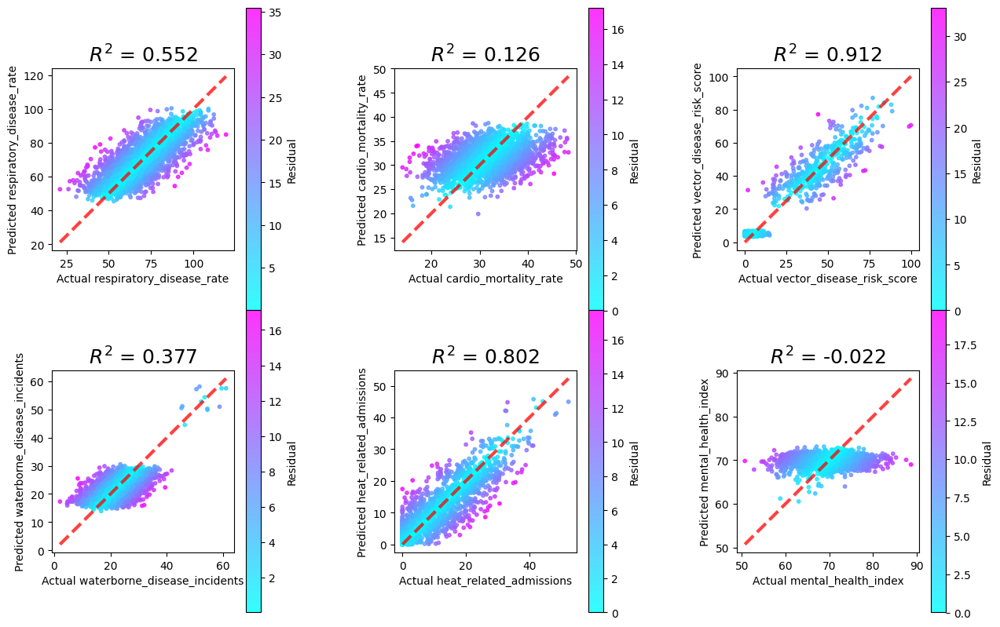

In [ ]:
plot_residuals(Y_test, model_rf.predict(X_test))

## 3.11: Tree Model With Lag


The results did not improve the compared to the original random forest regression.


In [ ]:
models_rf_lag, r2_summary_rf_lag, X_trains_rf_lag, X_tests_rf_lag, Y_trains_rf_lag, Y_tests_rf_lag = model_multiple_lags(
    init_multi_output_random_forest, df_date_indexed, lag_weeks, cols_to_lag
)
r2_summary_rf_lag

Temporal Split: Train (2015-2022): 10400 samples
Temporal Split: Test (2024-2025): 2350 samples
Temporal Split: Train (2015-2022): 10375 samples
Temporal Split: Test (2024-2025): 2350 samples
Temporal Split: Train (2015-2022): 10350 samples
Temporal Split: Test (2024-2025): 2350 samples


1                      \
                                train                       
                               Target R-squared      RMSE   
0            respiratory_disease_rate  0.901290  4.767805   
1               cardio_mortality_rate  0.854465  2.136413   
2           vector_disease_risk_score  0.970393  2.932874   
3        waterborne_disease_incidents  0.897179  2.127560   
4             heat_related_admissions  0.943701  2.243685   
5                 mental_health_index  0.855528  1.905841   
Overall                           NaN  0.903759  2.685696   

                                                            \
                                 test                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.284757  12.930693   
1               cardio_mortality_rate -0.051541   5.752457   
2           vector_disease_risk_score  0.775303   8.392288   
3        waterborne_disease_incidents  0.268960   5.580320   
4             heat_related_admissions  0.593526   6.249990   
5                 mental_health_index -0.057645   5.214761   
Overall                           NaN  0.302227   7.353418   

                                    2                      \
                                train                       
                               Target R-squared      RMSE   
0            respiratory_disease_rate  0.900790  4.780637   
1               cardio_mortality_rate  0.853693  2.141260   
2           vector_disease_risk_score  0.970060  2.951481   
3        waterborne_disease_incidents  0.897628  2.124048   
4             heat_related_admissions  0.943336  2.252805   
5                 mental_health_index  0.854203  1.915187   
Overall                           NaN  0.903285  2.694236   

                                                            \
                                 test                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.237779  13.381180   
1               cardio_mortality_rate -0.049858   5.754856   
2           vector_disease_risk_score  0.788587   8.161559   
3        waterborne_disease_incidents  0.268945   5.592205   
4             heat_related_admissions  0.590499   6.267738   
5                 mental_health_index -0.039873   5.153102   
Overall                           NaN  0.299346   7.385107   

                                    3                      \
                                train                       
                               Target R-squared      RMSE   
0            respiratory_disease_rate  0.900636  4.782819   
1               cardio_mortality_rate  0.856083  2.123187   
2           vector_disease_risk_score  0.970441  2.934719   
3        waterborne_disease_incidents  0.896305  2.138532   
4             heat_related_admissions  0.943496  2.251078   
5                 mental_health_index  0.855178  1.907639   
Overall                           NaN  0.903690  2.689662   

                                                            
                                 test                       
                               Target R-squared       RMSE  
0            respiratory_disease_rate  0.187555  13.792025  
1               cardio_mortality_rate -0.058700   5.779491  
2           vector_disease_risk_score  0.781232   8.310181  
3        waterborne_disease_incidents  0.262224   5.602133  
4             heat_related_admissions  0.595587   6.225952  
5                 mental_health_index -0.026026   5.127553  
Overall                           NaN  0.290312   7.472889

## 3.12: K-Nearest Neighbour Model


In [ ]:
from sklearn.neighbors import KNeighborsRegressor

def init_multi_output_knn(n_neighbours=5):
    """
    Instantiates a K-nearest neighbours regression model that handles multiple outputs separately.
    Does not train or evaluate it.
    """
    model = KNeighborsRegressor(n_neighbors=n_neighbours)
    return MultiOutputRegressor(model)

def prepare_train_analyze_knn_model(data, n_neighbours=5):
    model = init_multi_output_knn(n_neighbors=n_neighbours)
    return prepare_train_analyze_model(data, model)

knn_results = []
ks = list(range(5, 16, 5))
for k in ks:
    # Not using this function since it recreates the data split, when we can just reuse the sets for the original linear model
    # model_knn, r2_train_knn, r2_test_knn, X_train_knn, X_test_knn, Y_train_knn, Y_test_knn, X_cols_knn, Y_cols_knn = prepare_train_analyze_knn_model(data, n_neighbours=k)

    model_knn = init_multi_output_knn(n_neighbours=k)
    r2_train_knn, r2_test_knn = train_analyze_model(X_train, X_test, Y_train, Y_test, model_knn)
    r2_result = pd.concat([r2_train_knn, r2_test_knn], axis=1, keys=["train", "test"])
    knn_results.append(r2_result)
pd.concat(knn_results, axis=1, keys=ks)

5                       \
                                train                       
                               Target R-squared      RMSE   
0            respiratory_disease_rate  0.640345  9.098729   
1               cardio_mortality_rate  0.353842  4.500248   
2           vector_disease_risk_score  0.855643  6.472965   
3        waterborne_disease_incidents  0.540931  4.493769   
4             heat_related_admissions  0.827842  3.920624   
5                 mental_health_index  0.206055  4.471148   
Overall                           NaN  0.570776  5.492914   

                                                            \
                                 test                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.463558  11.218907   
1               cardio_mortality_rate  0.010049   5.576894   
2           vector_disease_risk_score  0.796152   7.977105   
3        waterborne_disease_incidents  0.280671   5.534379   
4             heat_related_admissions  0.726399   5.131355   
5                 mental_health_index -0.157932   5.449177   
Overall                           NaN  0.353150   6.814636   

                                   10                      \
                                train                       
                               Target R-squared      RMSE   
0            respiratory_disease_rate  0.584974  9.774064   
1               cardio_mortality_rate  0.271625  4.777980   
2           vector_disease_risk_score  0.830842  7.006956   
3        waterborne_disease_incidents  0.479447  4.785249   
4             heat_related_admissions  0.796367  4.263981   
5                 mental_health_index  0.110579  4.732358   
Overall                           NaN  0.512306  5.890098   

                                                            \
                                 test                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.500287  10.828033   
1               cardio_mortality_rate  0.070058   5.405222   
2           vector_disease_risk_score  0.801834   7.865147   
3        waterborne_disease_incidents  0.346500   5.275065   
4             heat_related_admissions  0.735246   5.047713   
5                 mental_health_index -0.086498   5.278418   
Overall                           NaN  0.394571   6.616600   

                                   15                       \
                                train                        
                               Target R-squared       RMSE   
0            respiratory_disease_rate  0.564361  10.013854   
1               cardio_mortality_rate  0.234154   4.899343   
2           vector_disease_risk_score  0.816257   7.302794   
3        waterborne_disease_incidents  0.456008   4.891794   
4             heat_related_admissions  0.778444   4.447674   
5                 mental_health_index  0.076526   4.822101   
Overall                           NaN  0.487625   6.062927   

                                                            
                                 test                       
                               Target R-squared       RMSE  
0            respiratory_disease_rate  0.506036  10.765563  
1               cardio_mortality_rate  0.085593   5.359883  
2           vector_disease_risk_score  0.798583   7.929399  
3        waterborne_disease_incidents  0.369599   5.181000  
4             heat_related_admissions  0.725987   5.135221  
5                 mental_health_index -0.054995   5.201332  
Overall                           NaN  0.405134   6.595400

# 4: Global Burden of Disease (GBD) Analysis

## Correlating Climate Factors with Disease Burden

This section integrates the IHME Global Burden of Disease dataset with climate indicators to analyze:

1. **Respiratory diseases** ↔ Air pollution, heat stress
2. **Cardiovascular diseases** ↔ Heat waves, extreme temperatures
3. **Infectious diseases** ↔ Water/sanitation risks, flooding


## 4.1: Load and Explore GBD Dataset


The original Global Burden of Disease (GBD) dataset was collected from https://vizhub.healthdata.org/gbd-results/, before being saved to a public drive to have our own copy for easier use.  This was also as there were concerns that this data might be updated more frequently than the other dataset (from Kaggle).

In [ ]:
import re

# Uploaded file from https://vizhub.healthdata.org/gbd-results/ to Google docs for convenience
GBD_DRIVE_LINK = "https://drive.google.com/file/d/11_Xo_P1vn8QViFhmWn4GNMTbOvNKKi39/view?usp=sharing"

def get_download_path_from_google_drive_url(url):
    # Extract file ID from various Google Drive URL formats
    match = re.search(r'id=([a-zA-Z0-9_-]+)', url) or \
            re.search(r'/file/d/([a-zA-Z0-9_-]+)', url)
    if match:
        file_id = match.group(1)
        download_url = f'https://drive.google.com/uc?export=download&id={file_id}'
        return download_url

    raise ValueError("Could not extract Google Drive ID from the provided URL.")

gbd_file_path = get_download_path_from_google_drive_url(GBD_DRIVE_LINK)

In [ ]:
# Load GBD dataset
# gbd_data = pd.read_csv('IHME-GBD_DATA_TEST.csv')
gbd_data = pd.read_csv(gbd_file_path)

print("GBD Dataset Shape:", gbd_data.shape)
print("\nColumns:", list(gbd_data.columns))
print("\nSample data:")
gbd_data.head(10)


GBD Dataset Shape: (41850, 10)

Columns: ['measure', 'location', 'sex', 'age', 'cause', 'metric', 'year', 'val', 'upper', 'lower']

Sample data:


,measure,location,sex,age,cause,metric,year,val,upper,lower
0,Deaths,Australia,Male,All ages,Rheumatic heart disease,Number,2015,168.364293,187.215384,147.411054
1,Deaths,Australia,Female,All ages,Rheumatic heart disease,Number,2015,314.054188,354.315800,262.373068
2,Deaths,Australia,Both,All ages,Rheumatic heart disease,Number,2015,482.418481,537.462465,418.063704
3,Deaths,Australia,Male,All ages,Ischemic heart disease,Number,2015,12541.382491,13242.286626,11555.689614
4,Deaths,Australia,Female,All ages,Ischemic heart disease,Number,2015,10292.038857,11486.338941,8229.982387
5,Deaths,Australia,Both,All ages,Ischemic heart disease,Number,2015,22833.421348,24583.088679,19815.227460
6,Deaths,Australia,Male,All ages,Stroke,Number,2015,4573.361956,4864.533417,4098.635924
7,Deaths,Australia,Female,All ages,Stroke,Number,2015,6932.127843,7776.572026,5500.295315
8,Deaths,Australia,Both,All ages,Stroke,Number,2015,11505.489799,12470.644969,9610.558335
9,Deaths,France,Male,All ages,Lower respiratory infections,Number,2015,10069.084466,11194.198938,8710.522187


In [ ]:
# Explore unique values in key columns
print("Measures:", gbd_data['measure'].unique())
print("\nLocations:", gbd_data['location'].unique())
print("\nYears:", sorted(gbd_data['year'].unique()))
print("\nNumber of unique causes:", gbd_data['cause'].nunique())
print("\nAll causes:")
for cause in sorted(gbd_data['cause'].unique()):
    print(f"  - {cause}")


Measures: ['Deaths' 'DALYs (Disability-Adjusted Life Years)']

Locations: ['Australia' 'France' 'Germany' 'Indonesia' 'Bangladesh' 'Viet Nam'
 'Canada' 'Colombia' 'Brazil' 'India' 'Kenya' 'Italy' 'Egypt' 'Spain'
 'China' 'Thailand' 'South Africa' 'Nigeria' 'Mexico' 'United Kingdom'
 'Japan' 'Philippines' 'Pakistan' 'United States of America' 'Argentina']

Years: [np.int64(2015), np.int64(2016), np.int64(2017), np.int64(2018), np.int64(2019), np.int64(2020), np.int64(2021), np.int64(2022), np.int64(2023)]

Number of unique causes: 31

All causes:
  - Acute hepatitis
  - Aortic aneurysm
  - Asthma
  - Atrial fibrillation and flutter
  - Cardiomyopathy and myocarditis
  - Chronic obstructive pulmonary disease
  - Diphtheria
  - Encephalitis
  - Endocarditis
  - Hypertensive heart disease
  - Interstitial lung disease and pulmonary sarcoidosis
  - Ischemic heart disease
  - Lower extremity peripheral arterial disease
  - Lower respiratory infections
  - Measles
  - Meningitis
  - Non-rheum

## 4.2: Missing/Duplicated Data


In [ ]:
print("Missing data:", gbd_data.isna().any().any())
print("Duplicated data:", gbd_data.duplicated().any())

Missing data: False
Duplicated data: False


## 4.3: Categorize Diseases into Climate-Related Groups

We categorize diseases based on their relationship with climate factors:

-   **Respiratory**: Affected by air pollution (PM2.5, AQI) and heat stress
-   **Cardiovascular**: Affected by heat waves and extreme temperatures
-   **Infectious**: Affected by water/sanitation issues, flooding, and temperature changes


In [ ]:
# Define disease categories based on climate relationships
RESPIRATORY_DISEASES = set([
    'Chronic obstructive pulmonary disease',
    'Asthma',
    'Lower respiratory infections',
    'Upper respiratory infections',
    'Pneumoconiosis',
    'Interstitial lung disease and pulmonary sarcoidosis',
    'Other chronic respiratory diseases'
])

CARDIOVASCULAR_DISEASES = set([
    'Ischemic heart disease',
    'Stroke',
    'Hypertensive heart disease',
    'Cardiomyopathy and myocarditis',
    'Atrial fibrillation and flutter',
    'Aortic aneurysm',
    'Lower extremity peripheral arterial disease',
    'Endocarditis',
    'Non-rheumatic valvular heart disease',
    'Rheumatic heart disease',
    'Pulmonary Arterial Hypertension',
    'Other cardiovascular and circulatory diseases'
])

INFECTIOUS_DISEASES = set([
    'Tuberculosis',
    'Meningitis',
    'Encephalitis',
    'Diphtheria',
    'Pertussis',
    'Tetanus',
    'Measles',
    'Varicella and herpes zoster',
    'Acute hepatitis',
    'Other unspecified infectious diseases',
    'Otitis media'
])

def categorize_disease(cause):
    """Categorize a disease into respiratory, cardiovascular, or infectious."""
    if cause in RESPIRATORY_DISEASES:
        return 'Respiratory'
    elif cause in CARDIOVASCULAR_DISEASES:
        return 'Cardiovascular'
    elif cause in INFECTIOUS_DISEASES:
        return 'Infectious'
    else:
        return 'Other'

# Apply categorization
gbd_data['disease_category'] = gbd_data['cause'].apply(categorize_disease)

# Show distribution
print("Disease Category Distribution:")
print(gbd_data['disease_category'].value_counts())


Disease Category Distribution:
disease_category
Cardiovascular    16200
Infectious        14850
Respiratory        9450
Other              1350
Name: count, dtype: int64


## 4.4: Prepare Data for Merging

Aggregate GBD data by location, year, and disease category (using Deaths, Both sexes, All ages).
Then aggregate climate data from weekly to annual for matching.


In [ ]:
# Filter GBD data: Deaths, Both sexes, All ages only
gbd_filtered = gbd_data[
    (gbd_data['measure'] == 'Deaths') &
    (gbd_data['sex'] == 'Both') &
    (gbd_data['age'] == 'All ages') &
    (gbd_data['disease_category'] != 'Other')  # Focus on our three categories
].copy()

print(f"Filtered GBD records: {len(gbd_filtered)}")

# Aggregate by location, year, and disease category
gbd_aggregated = gbd_filtered.groupby(['location', 'year', 'disease_category']).agg({
    'val': 'sum',
    'upper': 'sum',
    'lower': 'sum'
}).reset_index()

gbd_aggregated.columns = ['location', 'year', 'disease_category', 'deaths', 'deaths_upper', 'deaths_lower']

print(f"\nAggregated GBD records: {len(gbd_aggregated)}")
gbd_aggregated.head(10)


Filtered GBD records: 6750

Aggregated GBD records: 675


,location,year,disease_category,deaths,deaths_upper,deaths_lower
0,Argentina,2015,Cardiovascular,93361.200394,100313.575325,84570.696576
1,Argentina,2015,Infectious,1751.317941,1969.096115,1564.259422
2,Argentina,2015,Respiratory,54520.673416,59135.229587,48977.919064
3,Argentina,2016,Cardiovascular,98801.524686,106253.480397,89403.516003
4,Argentina,2016,Infectious,1785.593706,2009.775485,1594.560672
5,Argentina,2016,Respiratory,60253.252017,65361.791466,54251.533795
6,Argentina,2017,Cardiovascular,96254.037150,103885.586666,87019.117079
7,Argentina,2017,Infectious,1728.566922,1946.678323,1540.948740
8,Argentina,2017,Respiratory,60006.527514,65288.001829,54037.415456
9,Argentina,2018,Cardiovascular,94366.948343,101916.386543,85501.468023


In [ ]:
# Create mapping between GBD location names and climate data country names
LOCATION_MAPPING = {
    'Australia': 'Australia',
    'France': 'France',
    'Germany': 'Germany',
    'Indonesia': 'Indonesia',
    'India': 'India',
    'Pakistan': 'Pakistan',
    'United Kingdom': 'United Kingdom',
    'United States of America': 'United States',
    'Japan': 'Japan',
    'Brazil': 'Brazil',
    'China': 'China',
    'Nigeria': 'Nigeria',
    'South Africa': 'South Africa',
    'Mexico': 'Mexico',
    'Canada': 'Canada',
    'Italy': 'Italy',
    'Spain': 'Spain',
    'Thailand': 'Thailand',
    'Philippines': 'Philippines',
    'Viet Nam': 'Vietnam',
    'Egypt': 'Egypt',
    'Bangladesh': 'Bangladesh',
    'Argentina': 'Argentina',
    'Colombia': 'Colombia',
    'Kenya': 'Kenya'
}

# Aggregate climate data to annual level
climate_annual = data.groupby(['country_name', 'year']).agg({
    'temperature_celsius': 'mean',
    'temp_anomaly_celsius': 'mean',
    'precipitation_mm': 'sum',
    'heat_wave_days': 'sum',
    'drought_indicator': 'sum',
    'flood_indicator': 'sum',
    'extreme_weather_events': 'sum',
    'pm25_ugm3': 'mean',
    'air_quality_index': 'mean',
    'population_millions': 'first'
}).reset_index()

print("Climate data aggregated to annual level:")
print(f"Shape: {climate_annual.shape}")
climate_annual.head()


Climate data aggregated to annual level:
Shape: (275, 12)


/tmp/ipython-input-1970557779.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  climate_annual = data.groupby(['country_name', 'year']).agg({


,country_name,year,temperature_celsius,temp_anomaly_celsius,precipitation_mm,heat_wave_days,drought_indicator,flood_indicator,extreme_weather_events,pm25_ugm3,air_quality_index,population_millions
0,Argentina,2015,1.661538,-0.041154,4286.1,6,1,0,7,46.903846,72.788462,45
1,Argentina,2016,1.871154,-0.052500,4336.0,5,0,0,5,44.526923,66.423077,45
2,Argentina,2017,2.475849,0.029057,4622.9,10,0,1,11,47.143396,73.301887,45
3,Argentina,2018,1.262885,0.113462,4554.3,5,1,1,7,41.721154,62.942308,45
4,Argentina,2019,2.105192,0.075577,4032.4,6,2,2,10,49.609615,73.596154,45


In [ ]:
# Map GBD locations to climate country names
gbd_aggregated['country_name'] = gbd_aggregated['location'].map(LOCATION_MAPPING)

# Check which locations mapped successfully
print("Mapping results:")
print(f"  Total GBD records: {len(gbd_aggregated)}")
print(f"  Successfully mapped: {gbd_aggregated['country_name'].notna().sum()}")
print(f"  Unmapped locations: {gbd_aggregated[gbd_aggregated['country_name'].isna()]['location'].unique()}")

# Keep only mapped records
gbd_mapped = gbd_aggregated[gbd_aggregated['country_name'].notna()].copy()

# Merge GBD with climate data
merged_data = gbd_mapped.merge(
    climate_annual,
    on=['country_name', 'year'],
    how='inner'
)

print(f"\nMerged dataset shape: {merged_data.shape}")
print(f"Countries in merged data: {merged_data['country_name'].unique()}")
print(f"Years in merged data: {sorted(merged_data['year'].unique())}")
merged_data.head()


Mapping results:
  Total GBD records: 675
  Successfully mapped: 675
  Unmapped locations: []

Merged dataset shape: (675, 17)
Countries in merged data: ['Argentina' 'Australia' 'Bangladesh' 'Brazil' 'Canada' 'China' 'Colombia'
 'Egypt' 'France' 'Germany' 'India' 'Indonesia' 'Italy' 'Japan' 'Kenya'
 'Mexico' 'Nigeria' 'Pakistan' 'Philippines' 'South Africa' 'Spain'
 'Thailand' 'United Kingdom' 'United States' 'Vietnam']
Years in merged data: [np.int64(2015), np.int64(2016), np.int64(2017), np.int64(2018), np.int64(2019), np.int64(2020), np.int64(2021), np.int64(2022), np.int64(2023)]


,location,year,disease_category,deaths,deaths_upper,deaths_lower,country_name,temperature_celsius,temp_anomaly_celsius,precipitation_mm,heat_wave_days,drought_indicator,flood_indicator,extreme_weather_events,pm25_ugm3,air_quality_index,population_millions
0,Argentina,2015,Cardiovascular,93361.200394,100313.575325,84570.696576,Argentina,1.661538,-0.041154,4286.1,6,1,0,7,46.903846,72.788462,45
1,Argentina,2015,Infectious,1751.317941,1969.096115,1564.259422,Argentina,1.661538,-0.041154,4286.1,6,1,0,7,46.903846,72.788462,45
2,Argentina,2015,Respiratory,54520.673416,59135.229587,48977.919064,Argentina,1.661538,-0.041154,4286.1,6,1,0,7,46.903846,72.788462,45
3,Argentina,2016,Cardiovascular,98801.524686,106253.480397,89403.516003,Argentina,1.871154,-0.052500,4336.0,5,0,0,5,44.526923,66.423077,45
4,Argentina,2016,Infectious,1785.593706,2009.775485,1594.560672,Argentina,1.871154,-0.052500,4336.0,5,0,0,5,44.526923,66.423077,45


## 4.5: Correlation Analysis: Climate Factors vs Disease Burden

Analyze correlations between:

-   **Respiratory diseases** and PM2.5, AQI, temperature
-   **Cardiovascular diseases** and heat wave days, extreme temperatures
-   **Infectious diseases** and flooding, precipitation, drought


In [ ]:
# Calculate deaths per million population for fair comparison across countries
merged_data['deaths_per_million'] = merged_data['deaths'] / merged_data['population_millions']

# Define climate features for each disease category
RESPIRATORY_CLIMATE_FEATURES = ['pm25_ugm3', 'air_quality_index', 'temperature_celsius', 'temp_anomaly_celsius']
CARDIOVASCULAR_CLIMATE_FEATURES = ['heat_wave_days', 'temperature_celsius', 'temp_anomaly_celsius', 'extreme_weather_events']
INFECTIOUS_CLIMATE_FEATURES = ['flood_indicator', 'precipitation_mm', 'drought_indicator', 'temperature_celsius']

# Calculate correlations for each disease category
def calculate_correlations(data, disease_cat, features):
    """Calculate correlation between deaths and climate features for a disease category."""
    cat_data = data[data['disease_category'] == disease_cat]
    correlations = {}
    for feature in features:
        if feature in cat_data.columns:
            corr = cat_data['deaths_per_million'].corr(cat_data[feature])
            correlations[feature] = corr
    return correlations

print("="*70)
print("CORRELATION ANALYSIS: Climate Factors vs Disease Burden")
print("="*70)

for cat, features in [
    ('Respiratory', RESPIRATORY_CLIMATE_FEATURES),
    ('Cardiovascular', CARDIOVASCULAR_CLIMATE_FEATURES),
    ('Infectious', INFECTIOUS_CLIMATE_FEATURES)
]:
    print(f"\n{cat} Diseases:")
    print("-"*40)
    correlations = calculate_correlations(merged_data, cat, features)
    for feature, corr in sorted(correlations.items(), key=lambda x: abs(x[1]), reverse=True):
        strength = "Strong" if abs(corr) > 0.5 else "Moderate" if abs(corr) > 0.3 else "Weak"
        direction = "positive" if corr > 0 else "negative"
        print(f"  {feature:30} r = {corr:+.4f} ({strength} {direction})")


CORRELATION ANALYSIS: Climate Factors vs Disease Burden

Respiratory Diseases:
----------------------------------------
  temperature_celsius            r = -0.4110 (Moderate negative)
  air_quality_index              r = -0.1845 (Weak negative)
  pm25_ugm3                      r = -0.1832 (Weak negative)
  temp_anomaly_celsius           r = -0.0522 (Weak negative)

Cardiovascular Diseases:
----------------------------------------
  temperature_celsius            r = -0.6120 (Strong negative)
  temp_anomaly_celsius           r = +0.1030 (Weak positive)
  heat_wave_days                 r = +0.0535 (Weak positive)
  extreme_weather_events         r = +0.0484 (Weak positive)

Infectious Diseases:
----------------------------------------
  temperature_celsius            r = +0.5071 (Strong positive)
  flood_indicator                r = +0.0683 (Weak positive)
  precipitation_mm               r = +0.0100 (Weak positive)
  drought_indicator              r = -0.0054 (Weak negative)


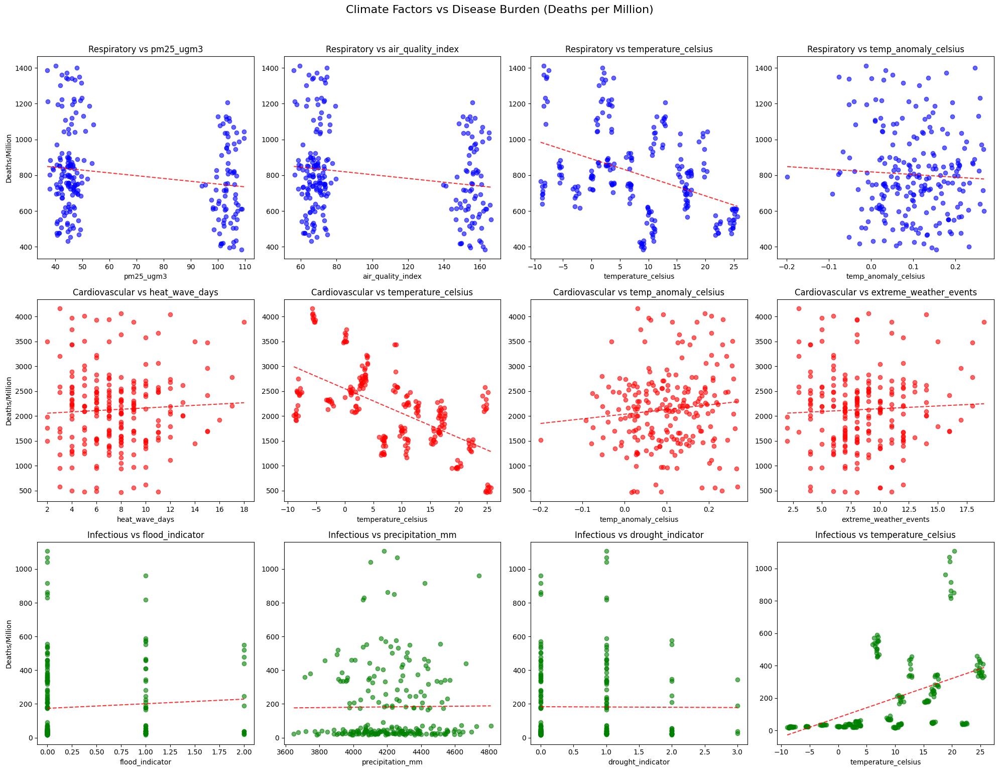

In [ ]:
# Visualize correlations with scatter plots
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
fig.suptitle('Climate Factors vs Disease Burden (Deaths per Million)', fontsize=16, y=1.02)

# Respiratory diseases
resp_data = merged_data[merged_data['disease_category'] == 'Respiratory']
for i, feature in enumerate(RESPIRATORY_CLIMATE_FEATURES):
    ax = axes[0, i]
    ax.scatter(resp_data[feature], resp_data['deaths_per_million'], alpha=0.6, c='blue')
    ax.set_xlabel(feature)
    ax.set_ylabel('Deaths/Million' if i == 0 else '')
    ax.set_title(f'Respiratory vs {feature}')
    # Add trend line
    z = np.polyfit(resp_data[feature], resp_data['deaths_per_million'], 1)
    p = np.poly1d(z)
    ax.plot(resp_data[feature].sort_values(), p(resp_data[feature].sort_values()), "r--", alpha=0.8)

# Cardiovascular diseases
cardio_data = merged_data[merged_data['disease_category'] == 'Cardiovascular']
for i, feature in enumerate(CARDIOVASCULAR_CLIMATE_FEATURES):
    ax = axes[1, i]
    ax.scatter(cardio_data[feature], cardio_data['deaths_per_million'], alpha=0.6, c='red')
    ax.set_xlabel(feature)
    ax.set_ylabel('Deaths/Million' if i == 0 else '')
    ax.set_title(f'Cardiovascular vs {feature}')
    z = np.polyfit(cardio_data[feature], cardio_data['deaths_per_million'], 1)
    p = np.poly1d(z)
    ax.plot(cardio_data[feature].sort_values(), p(cardio_data[feature].sort_values()), "r--", alpha=0.8)

# Infectious diseases
infect_data = merged_data[merged_data['disease_category'] == 'Infectious']
for i, feature in enumerate(INFECTIOUS_CLIMATE_FEATURES):
    ax = axes[2, i]
    ax.scatter(infect_data[feature], infect_data['deaths_per_million'], alpha=0.6, c='green')
    ax.set_xlabel(feature)
    ax.set_ylabel('Deaths/Million' if i == 0 else '')
    ax.set_title(f'Infectious vs {feature}')
    z = np.polyfit(infect_data[feature], infect_data['deaths_per_million'], 1)
    p = np.poly1d(z)
    ax.plot(infect_data[feature].sort_values(), p(infect_data[feature].sort_values()), "r--", alpha=0.8)

plt.tight_layout()
plt.show()


## 4.6: Predictive Modeling: Climate → Disease Burden

Build regression models to predict disease burden from climate factors for each category:

1. **Respiratory diseases** ← Air pollution + heat stress features
2. **Cardiovascular diseases** ← Heat wave + temperature features
3. **Infectious diseases** ← Water/flooding + climate features


In [ ]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

def build_disease_model(data, disease_category, climate_features, model_name='Ridge'):
    """
    Build and evaluate a predictive model for a disease category.

    Args:
        data: Merged dataset
        disease_category: 'Respiratory', 'Cardiovascular', or 'Infectious'
        climate_features: List of climate feature columns
        model_name: 'Ridge', 'RandomForest', or 'GradientBoosting'

    Returns:
        Dictionary with model performance metrics
    """
    # Filter data for this disease category
    cat_data = data[data['disease_category'] == disease_category].copy()

    if len(cat_data) < 10:
        return {'error': f'Insufficient data for {disease_category}'}

    # Prepare features and target
    X = cat_data[climate_features].values
    y = cat_data['deaths_per_million'].values

    # Split data (temporal split if possible, otherwise random)
    years = cat_data['year'].values
    if len(np.unique(years)) > 1:
        # Use most recent year as test
        max_year = years.max()
        train_mask = years < max_year
        test_mask = years == max_year
        X_train, X_test = X[train_mask], X[test_mask]
        y_train, y_test = y[train_mask], y[test_mask]
    else:
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Select model
    if model_name == 'Ridge':
        model = Ridge(alpha=1.0)
    elif model_name == 'RandomForest':
        model = RandomForestRegressor(n_estimators=100, random_state=42, max_depth=5)
    elif model_name == 'GradientBoosting':
        model = GradientBoostingRegressor(n_estimators=100, random_state=42, max_depth=3)
    else:
        model = LinearRegression()

    # Train and evaluate
    model.fit(X_train_scaled, y_train)
    y_pred_train = model.predict(X_train_scaled)
    y_pred_test = model.predict(X_test_scaled)

    results = {
        'disease_category': disease_category,
        'model': model_name,
        'n_train': len(y_train),
        'n_test': len(y_test),
        'train_r2': r2_score(y_train, y_pred_train),
        'test_r2': r2_score(y_test, y_pred_test),
        'test_rmse': np.sqrt(mean_squared_error(y_test, y_pred_test)),
        'test_mae': mean_absolute_error(y_test, y_pred_test)
    }

    # Get feature importances if available
    if hasattr(model, 'feature_importances_'):
        results['feature_importance'] = dict(zip(climate_features, model.feature_importances_))
    elif hasattr(model, 'coef_'):
        results['coefficients'] = dict(zip(climate_features, model.coef_))

    return results, model, scaler


In [ ]:
# Build models for each disease category
print("="*70)
print("PREDICTIVE MODELING: Climate Factors → Disease Burden")
print("="*70)

# All climate features for comprehensive models
ALL_CLIMATE_FEATURES = [
    'temperature_celsius', 'temp_anomaly_celsius', 'precipitation_mm',
    'heat_wave_days', 'drought_indicator', 'flood_indicator',
    'extreme_weather_events', 'pm25_ugm3', 'air_quality_index'
]

model_results = []
trained_models = {}

for category, specific_features in [
    ('Respiratory', RESPIRATORY_CLIMATE_FEATURES),
    ('Cardiovascular', CARDIOVASCULAR_CLIMATE_FEATURES),
    ('Infectious', INFECTIOUS_CLIMATE_FEATURES)
]:
    print(f"\n{'='*70}")
    print(f"{category.upper()} DISEASES")
    print(f"{'='*70}")
    print(f"Features: {specific_features}")

    for model_name in ['Ridge', 'RandomForest', 'GradientBoosting']:
        try:
            result, model, scaler = build_disease_model(
                merged_data, category, specific_features, model_name
            )
            model_results.append(result)
            trained_models[f"{category}_{model_name}"] = (model, scaler)

            print(f"\n{model_name}:")
            print(f"  Train R²: {result['train_r2']:.4f}")
            print(f"  Test R²:  {result['test_r2']:.4f}")
            print(f"  Test RMSE: {result['test_rmse']:.2f}")

            if 'feature_importance' in result:
                print("  Feature Importances:")
                for feat, imp in sorted(result['feature_importance'].items(), key=lambda x: x[1], reverse=True):
                    print(f"    {feat}: {imp:.4f}")
            elif 'coefficients' in result:
                print("  Coefficients:")
                for feat, coef in sorted(result['coefficients'].items(), key=lambda x: abs(x[1]), reverse=True):
                    print(f"    {feat}: {coef:+.4f}")
        except Exception as e:
            print(f"\n{model_name}: Error - {e}")


PREDICTIVE MODELING: Climate Factors → Disease Burden

RESPIRATORY DISEASES
Features: ['pm25_ugm3', 'air_quality_index', 'temperature_celsius', 'temp_anomaly_celsius']

Ridge:
  Train R²: 0.1895
  Test R²:  0.0066
  Test RMSE: 247.23
  Coefficients:
    temperature_celsius: -111.3580
    pm25_ugm3: +24.0789
    temp_anomaly_celsius: -19.4914
    air_quality_index: -3.6753

RandomForest:
  Train R²: 0.8537
  Test R²:  0.4574
  Test RMSE: 182.71
  Feature Importances:
    temperature_celsius: 0.7503
    pm25_ugm3: 0.0973
    temp_anomaly_celsius: 0.0958
    air_quality_index: 0.0566

GradientBoosting:
  Train R²: 0.9357
  Test R²:  0.4214
  Test RMSE: 188.68
  Feature Importances:
    temperature_celsius: 0.7914
    pm25_ugm3: 0.0877
    temp_anomaly_celsius: 0.0674
    air_quality_index: 0.0536

CARDIOVASCULAR DISEASES
Features: ['heat_wave_days', 'temperature_celsius', 'temp_anomaly_celsius', 'extreme_weather_events']

Ridge:
  Train R²: 0.4027
  Test R²:  0.2735
  Test RMSE: 679.90
  

In [ ]:
# Summary comparison of all models
results_df = pd.DataFrame(model_results)
results_df = results_df[['disease_category', 'model', 'n_train', 'n_test', 'train_r2', 'test_r2', 'test_rmse', 'test_mae']]
best_models = {}

print("\n" + "="*70)
print("MODEL COMPARISON SUMMARY")
print("="*70)
print(results_df.to_string(index=False))

# Find best model for each disease category
print("\n" + "="*70)
print("BEST MODELS BY DISEASE CATEGORY")
print("="*70)
for category in ['Respiratory', 'Cardiovascular', 'Infectious']:
    cat_results = results_df[results_df['disease_category'] == category]
    if len(cat_results) > 0:
        best_idx = cat_results['test_r2'].idxmax()
        best = cat_results.loc[best_idx]
        print(f"\n{category}:")
        print(f"  Best Model: {best['model']}")
        print(f"  Test R²: {best['test_r2']:.4f}")
        print(f"  Test RMSE: {best['test_rmse']:.2f}")

        best_model_name = category + "_" + best["model"]
        best_models[category] = {
            "name": best_model_name,
            "model": trained_models[best_model_name][0],
            "scaler": trained_models[best_model_name][1]
        }



MODEL COMPARISON SUMMARY
disease_category            model  n_train  n_test  train_r2  test_r2  test_rmse   test_mae
     Respiratory            Ridge      200      25  0.189523 0.006603 247.231527 189.923476
     Respiratory     RandomForest      200      25  0.853681 0.457434 182.712714 127.738058
     Respiratory GradientBoosting      200      25  0.935651 0.421427 188.678216 143.182838
  Cardiovascular            Ridge      200      25  0.402665 0.273486 679.896644 567.285128
  Cardiovascular     RandomForest      200      25  0.866490 0.551321 534.304502 376.521305
  Cardiovascular GradientBoosting      200      25  0.960587 0.561253 528.357672 378.333326
      Infectious            Ridge      200      25  0.270979 0.187769 183.806182 128.089431
      Infectious     RandomForest      200      25  0.952827 0.951972  44.695840  28.679707
      Infectious GradientBoosting      200      25  0.989540 0.948826  46.136558  34.626609

BEST MODELS BY DISEASE CATEGORY

Respiratory:
  Best 

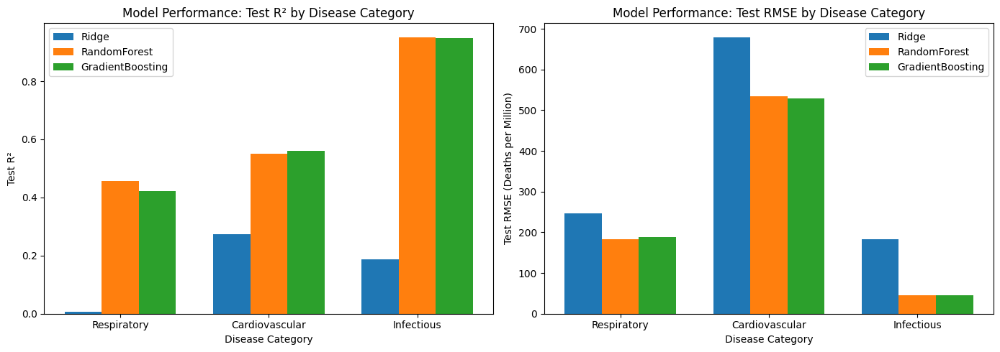

In [ ]:
# Visualize model performance comparison
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# R² comparison
ax1 = axes[0]
categories = results_df['disease_category'].unique()
x = np.arange(len(categories))
width = 0.25

for i, model in enumerate(['Ridge', 'RandomForest', 'GradientBoosting']):
    model_data = results_df[results_df['model'] == model]
    r2_values = [model_data[model_data['disease_category'] == cat]['test_r2'].values[0]
                 if len(model_data[model_data['disease_category'] == cat]) > 0 else 0
                 for cat in categories]
    ax1.bar(x + i*width, r2_values, width, label=model)

ax1.set_xlabel('Disease Category')
ax1.set_ylabel('Test R²')
ax1.set_title('Model Performance: Test R² by Disease Category')
ax1.set_xticks(x + width)
ax1.set_xticklabels(categories)
ax1.legend()
ax1.axhline(y=0, color='black', linestyle='-', linewidth=0.5)

# RMSE comparison
ax2 = axes[1]
for i, model in enumerate(['Ridge', 'RandomForest', 'GradientBoosting']):
    model_data = results_df[results_df['model'] == model]
    rmse_values = [model_data[model_data['disease_category'] == cat]['test_rmse'].values[0]
                   if len(model_data[model_data['disease_category'] == cat]) > 0 else 0
                   for cat in categories]
    ax2.bar(x + i*width, rmse_values, width, label=model)

ax2.set_xlabel('Disease Category')
ax2.set_ylabel('Test RMSE (Deaths per Million)')
ax2.set_title('Model Performance: Test RMSE by Disease Category')
ax2.set_xticks(x + width)
ax2.set_xticklabels(categories)
ax2.legend()

plt.tight_layout()
plt.show()


## 4.7: Key Findings: Climate-Disease Relationships

### Respiratory Diseases ↔ Air Pollution

-   **Expected relationship**: Higher PM2.5 and AQI → Higher respiratory disease burden
-   Key features: `pm25_ugm3`, `air_quality_index`, `temperature_celsius`

### Cardiovascular Diseases ↔ Heat Stress

-   **Expected relationship**: More heat waves and extreme temperatures → Higher cardiovascular mortality
-   Key features: `heat_wave_days`, `temp_anomaly_celsius`, `extreme_weather_events`

### Infectious Diseases ↔ Water/Sanitation

-   **Expected relationship**: Flooding and drought → Higher waterborne/vector-borne disease risk
-   Key features: `flood_indicator`, `precipitation_mm`, `drought_indicator`

### Limitations

1. GBD data is annual; climate data aggregated from weekly loses some granularity
2. Country-level aggregation masks regional variations
3. Correlation ≠ causation; many confounding factors exist
4. Limited overlap between datasets (matching countries/years)


## 4.8: Projecting Forward In Time

### 4.8.1: Project Underlying Climate Trends Forward a Few Years

In [ ]:
def get_monthly_trend(df, col):
    """
    Decompose time series and return only the monthly trend line.
    Assumes 12 periods (i.e. annual seasonality).
    """
    return seasonal_decompose(df[col].resample(MONTH_END_FREQ).mean(), period=12).trend

def project_future_trend(df, col, months):
    """
    Get the overall underlying monthly TREND for the given column (using a seasonal
    decomposition), then do a simple projection of future values based on the
    average month-to-month change in the trend line. This gives a new time series
    estimating the average values for that column out to some number of months.

    NOTE: Ignores seasonal cycles, only cares about overall trend.
    """
    trend = get_monthly_trend(df, col).dropna()
    monthly_change = trend.diff().dropna().mean()

    last_idx = trend.index[-1]
    last_val = trend.iloc[-1]

    future_dates = []
    future_vals = []
    for month in range(1, months+1):
        future_dates.append(last_idx + month * trend.index.freq)
        future_vals.append(last_val + month * monthly_change)

    return pd.Series(future_vals, index=future_dates)

monthly_projections = {}
for col in continuous_variables:
    monthly_projections[col] = project_future_trend(df_date_indexed, col, 60)
monthly_projections = pd.DataFrame(monthly_projections)
monthly_projections.tail(10)

,latitude,longitude,population_millions,temperature_celsius,temp_anomaly_celsius,precipitation_mm,heat_wave_days,drought_indicator,flood_indicator,extreme_weather_events,...,air_quality_index,respiratory_disease_rate,cardio_mortality_rate,vector_disease_risk_score,waterborne_disease_incidents,heat_related_admissions,healthcare_access_index,gdp_per_capita_usd,mental_health_index,food_security_index
2029-07-31,18.9052,27.3496,217.44,8.731267,0.332453,79.964864,0.139162,0.015016,0.000953,0.155131,...,98.745180,70.133235,31.940550,12.383581,22.185340,7.103297,64.811844,30669.397137,69.596681,93.394829
2029-08-31,18.9052,27.3496,217.44,8.732919,0.334255,79.964435,0.139130,0.015052,0.000926,0.155108,...,98.747728,70.135024,31.952516,12.387492,22.184922,7.106043,64.811439,30708.970741,69.593706,93.395638
2029-09-30,18.9052,27.3496,217.44,8.734572,0.336058,79.964006,0.139097,0.015089,0.000899,0.155085,...,98.750277,70.136813,31.964482,12.391403,22.184505,7.108788,64.811034,30748.544345,69.590731,93.396447
2029-10-31,18.9052,27.3496,217.44,8.736224,0.337860,79.963577,0.139064,0.015126,0.000872,0.155062,...,98.752825,70.138603,31.976448,12.395314,22.184087,7.111533,64.810630,30788.117949,69.587755,93.397256
2029-11-30,18.9052,27.3496,217.44,8.737877,0.339662,79.963148,0.139031,0.015163,0.000845,0.155039,...,98.755373,70.140392,31.988414,12.399225,22.183670,7.114279,64.810225,30827.691553,69.584780,93.398065
2029-12-31,18.9052,27.3496,217.44,8.739529,0.341464,79.962719,0.138999,0.015200,0.000818,0.155016,...,98.757921,70.142181,32.000381,12.403135,22.183252,7.117024,64.809820,30867.265157,69.581805,93.398874
2030-01-31,18.9052,27.3496,217.44,8.741182,0.343267,79.962290,0.138966,0.015236,0.000791,0.154993,...,98.760469,70.143970,32.012347,12.407046,22.182835,7.119769,64.809415,30906.838761,69.578830,93.399682
2030-02-28,18.9052,27.3496,217.44,8.742834,0.345069,79.961860,0.138933,0.015273,0.000764,0.154970,...,98.763018,70.145760,32.024313,12.410957,22.182417,7.122515,64.809011,30946.412365,69.575854,93.400491
2030-03-31,18.9052,27.3496,217.44,8.744487,0.346871,79.961431,0.138900,0.015310,0.000736,0.154947,...,98.765566,70.147549,32.036279,12.414868,22.182000,7.125260,64.808606,30985.985969,69.572879,93.401300
2030-04-30,18.9052,27.3496,217.44,8.746139,0.348673,79.961002,0.138868,0.015347,0.000709,0.154924,...,98.768114,70.149338,32.048245,12.418779,22.181582,7.128006,64.808201,31025.559573,69.569904,93.402109


### 4.8.2: Make Predictions on Future Global Health Impacts

In [ ]:
last_climate_projections = monthly_projections.tail(1)

for category, model_vals in best_models.items():
    best_name = model_vals["name"]
    best_model = model_vals["model"]
    best_scaler = model_vals["scaler"]

    disease_category_to_features = {
        'Respiratory': RESPIRATORY_CLIMATE_FEATURES,
        'Cardiovascular': CARDIOVASCULAR_CLIMATE_FEATURES,
        'Infectious': INFECTIOUS_CLIMATE_FEATURES
    }
    model_features = disease_category_to_features[category]
    future_feature_vals = last_climate_projections[model_features]
    future_feature_vals = best_scaler.transform(future_feature_vals.to_numpy())

    print(best_name, best_model.predict(future_feature_vals))


Respiratory_RandomForest [601.20209731]
Cardiovascular_GradientBoosting [3019.05986874]
Infectious_RandomForest [59.88671457]


## 4.9: Visualizing Climate-Disease Relationships


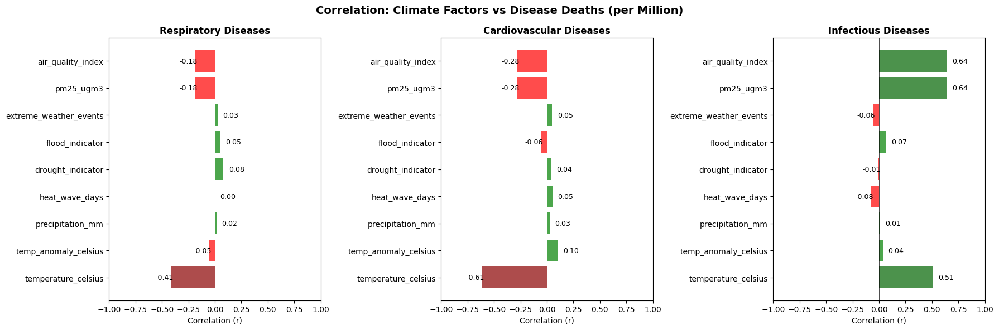

In [ ]:
# Create correlation heatmap for each disease category
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle('Correlation: Climate Factors vs Disease Deaths (per Million)', fontsize=14, fontweight='bold')

climate_cols = ['temperature_celsius', 'temp_anomaly_celsius', 'precipitation_mm',
                'heat_wave_days', 'drought_indicator', 'flood_indicator',
                'extreme_weather_events', 'pm25_ugm3', 'air_quality_index']

for idx, (category, color) in enumerate([('Respiratory', 'Blues'),
                                          ('Cardiovascular', 'Reds'),
                                          ('Infectious', 'Greens')]):
    ax = axes[idx]
    cat_data = merged_data[merged_data['disease_category'] == category]

    # Calculate correlations
    correlations = []
    for col in climate_cols:
        corr = cat_data['deaths_per_million'].corr(cat_data[col])
        correlations.append(corr)

    # Create horizontal bar chart
    colors = ['darkred' if c < -0.3 else 'red' if c < 0 else 'darkgreen' if c > 0.3 else 'green'
              for c in correlations]

    y_pos = np.arange(len(climate_cols))
    bars = ax.barh(y_pos, correlations, color=colors, alpha=0.7)

    ax.set_yticks(y_pos)
    ax.set_yticklabels(climate_cols)
    ax.set_xlabel('Correlation (r)')
    ax.set_title(f'{category} Diseases', fontsize=12, fontweight='bold')
    ax.axvline(x=0, color='black', linestyle='-', linewidth=0.5)
    ax.set_xlim(-1, 1)

    # Add correlation values on bars
    for bar, corr in zip(bars, correlations):
        width = bar.get_width()
        ax.text(width + 0.05 if width >= 0 else width - 0.15,
                bar.get_y() + bar.get_height()/2,
                f'{corr:.2f}', va='center', fontsize=9)

plt.tight_layout()
plt.show()


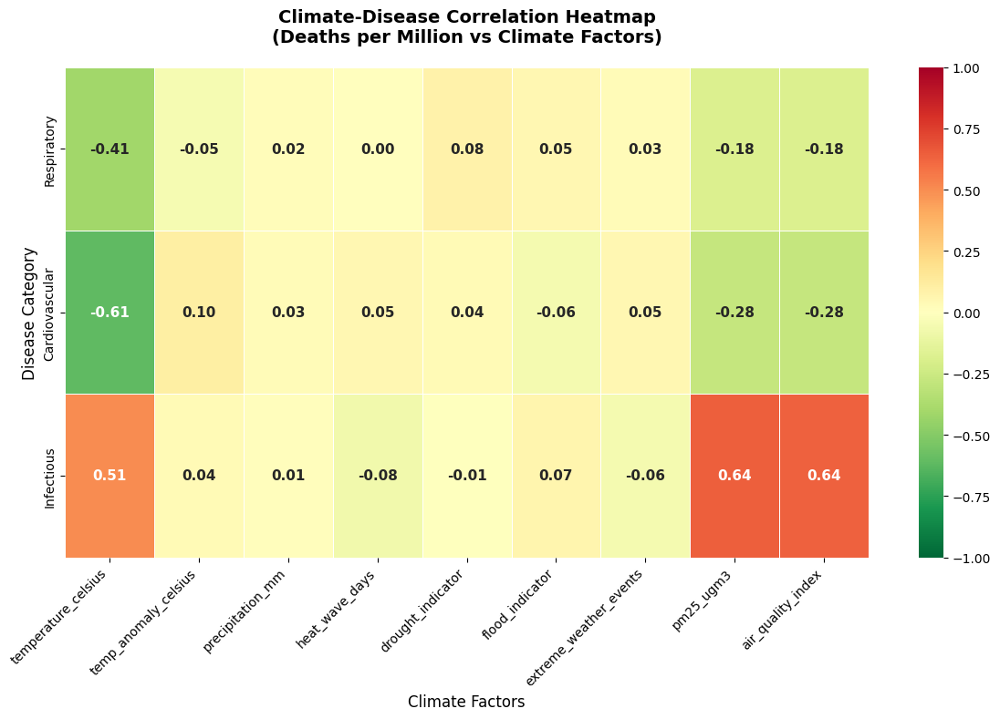


Interpretation:
  • Green (negative): Higher climate factor → Lower deaths
  • Red (positive): Higher climate factor → Higher deaths
  • Values closer to ±1 indicate stronger relationships


In [ ]:
# Create a comprehensive correlation heatmap
fig, ax = plt.subplots(figsize=(12, 8))

# Build correlation matrix
corr_matrix = []
categories = ['Respiratory', 'Cardiovascular', 'Infectious']

for category in categories:
    cat_data = merged_data[merged_data['disease_category'] == category]
    row = []
    for col in climate_cols:
        corr = cat_data['deaths_per_million'].corr(cat_data[col])
        row.append(corr)
    corr_matrix.append(row)

corr_df = pd.DataFrame(corr_matrix, index=categories, columns=climate_cols)

# Plot heatmap
sns.heatmap(corr_df, annot=True, fmt='.2f', cmap='RdYlGn_r', center=0,
            vmin=-1, vmax=1, linewidths=0.5, ax=ax,
            annot_kws={'size': 11, 'fontweight': 'bold'})

ax.set_title('Climate-Disease Correlation Heatmap\n(Deaths per Million vs Climate Factors)',
             fontsize=14, fontweight='bold', pad=20)
ax.set_xlabel('Climate Factors', fontsize=12)
ax.set_ylabel('Disease Category', fontsize=12)

# Rotate x-axis labels
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

print("\nInterpretation:")
print("  • Green (negative): Higher climate factor → Lower deaths")
print("  • Red (positive): Higher climate factor → Higher deaths")
print("  • Values closer to ±1 indicate stronger relationships")


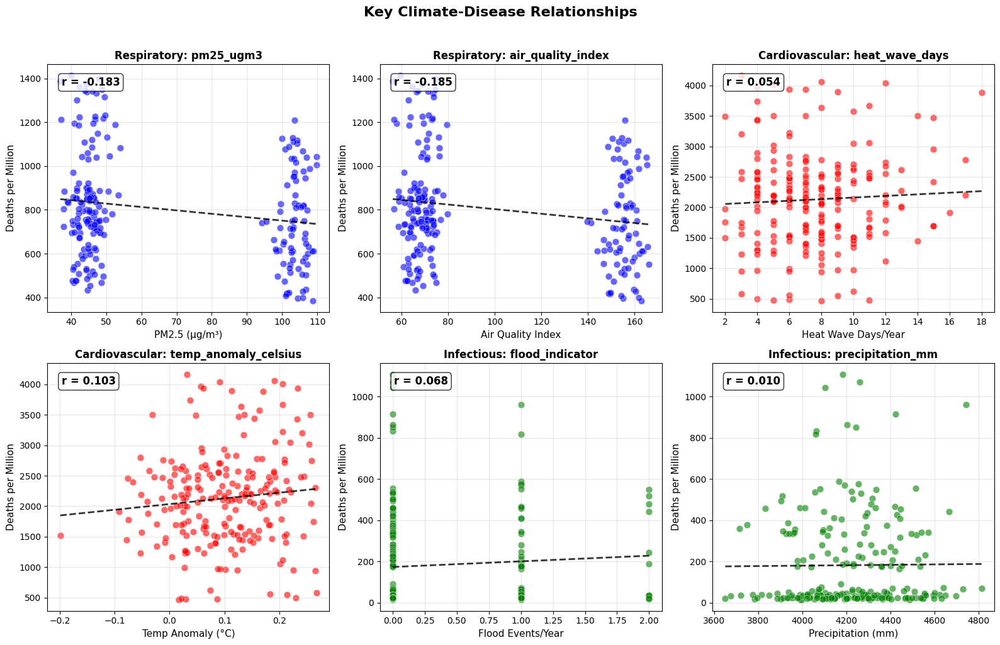

In [ ]:
# Key relationship scatter plots with regression lines
fig, axes = plt.subplots(2, 3, figsize=(16, 10))
fig.suptitle('Key Climate-Disease Relationships', fontsize=16, fontweight='bold', y=1.02)

# Define key relationships to visualize
key_relationships = [
    ('Respiratory', 'pm25_ugm3', 'PM2.5 (μg/m³)', 'blue'),
    ('Respiratory', 'air_quality_index', 'Air Quality Index', 'blue'),
    ('Cardiovascular', 'heat_wave_days', 'Heat Wave Days/Year', 'red'),
    ('Cardiovascular', 'temp_anomaly_celsius', 'Temp Anomaly (°C)', 'red'),
    ('Infectious', 'flood_indicator', 'Flood Events/Year', 'green'),
    ('Infectious', 'precipitation_mm', 'Precipitation (mm)', 'green'),
]

for idx, (category, feature, xlabel, color) in enumerate(key_relationships):
    ax = axes[idx // 3, idx % 3]
    cat_data = merged_data[merged_data['disease_category'] == category]

    # Scatter plot
    ax.scatter(cat_data[feature], cat_data['deaths_per_million'],
               alpha=0.6, c=color, s=60, edgecolors='white', linewidth=0.5)

    # Add regression line
    z = np.polyfit(cat_data[feature], cat_data['deaths_per_million'], 1)
    p = np.poly1d(z)
    x_line = np.linspace(cat_data[feature].min(), cat_data[feature].max(), 100)
    ax.plot(x_line, p(x_line), 'k--', linewidth=2, alpha=0.8, label='Trend')

    # Calculate and display correlation
    corr = cat_data['deaths_per_million'].corr(cat_data[feature])
    ax.text(0.05, 0.95, f'r = {corr:.3f}', transform=ax.transAxes,
            fontsize=12, fontweight='bold', verticalalignment='top',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

    ax.set_xlabel(xlabel, fontsize=11)
    ax.set_ylabel('Deaths per Million', fontsize=11)
    ax.set_title(f'{category}: {feature}', fontsize=12, fontweight='bold')
    ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


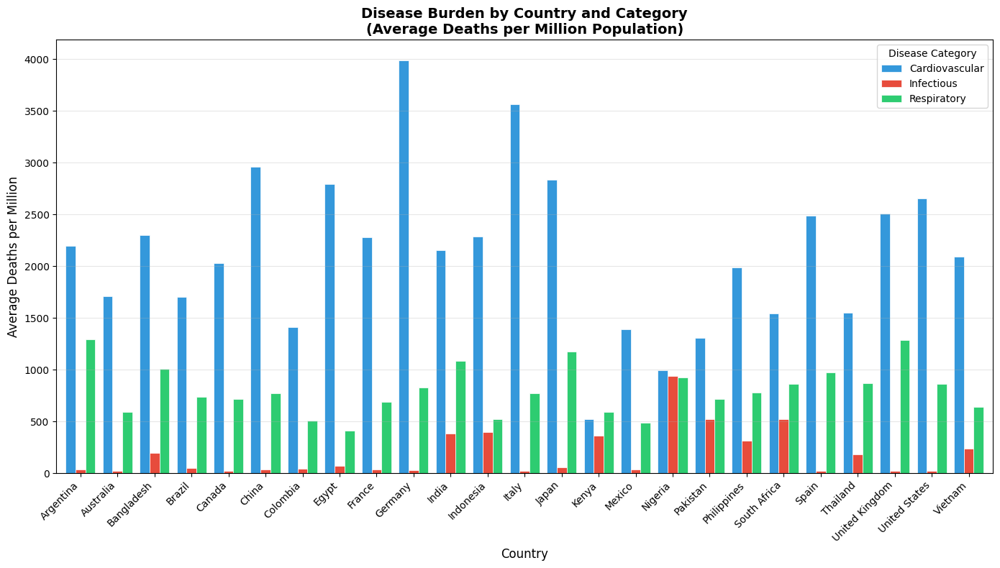

In [ ]:
# Disease burden by country - grouped bar chart
fig, ax = plt.subplots(figsize=(14, 8))

# Aggregate by country and disease category
country_disease = merged_data.groupby(['country_name', 'disease_category'])['deaths_per_million'].mean().unstack()

# Plot grouped bar chart
country_disease.plot(kind='bar', ax=ax, width=0.8,
                     color=['#3498db', '#e74c3c', '#2ecc71'],
                     edgecolor='white', linewidth=0.5)

ax.set_xlabel('Country', fontsize=12)
ax.set_ylabel('Average Deaths per Million', fontsize=12)
ax.set_title('Disease Burden by Country and Category\n(Average Deaths per Million Population)',
             fontsize=14, fontweight='bold')
ax.legend(title='Disease Category', loc='upper right')
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
ax.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()


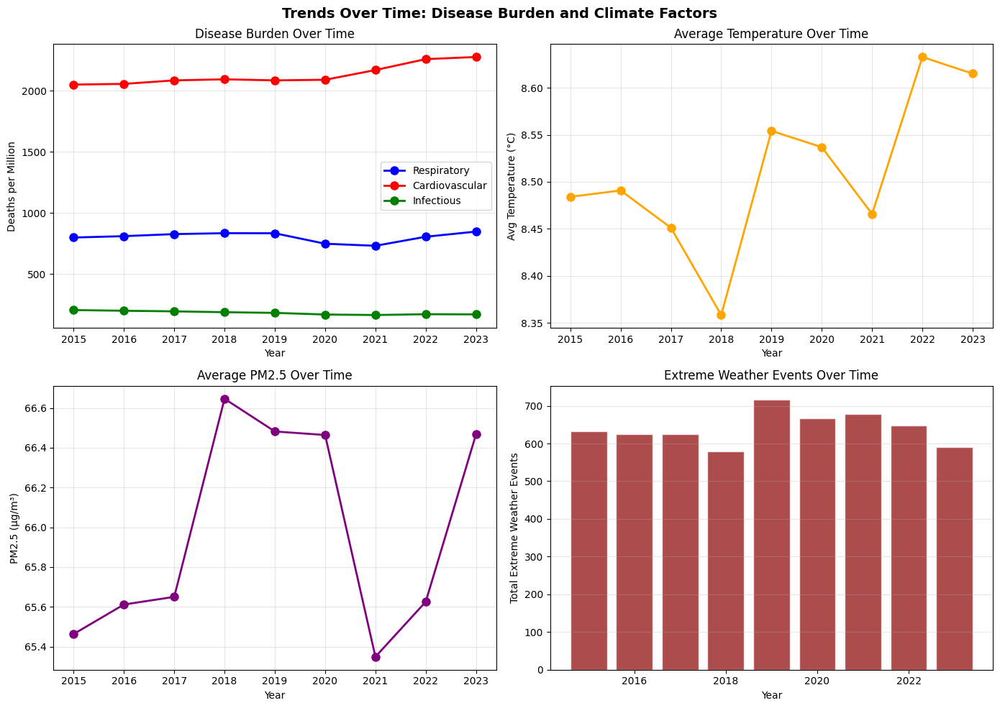

In [ ]:
# Time trend: Disease burden and climate factors over years
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle('Trends Over Time: Disease Burden and Climate Factors', fontsize=14, fontweight='bold')

# Aggregate by year
yearly_data = merged_data.groupby(['year', 'disease_category']).agg({
    'deaths_per_million': 'mean',
    'temperature_celsius': 'mean',
    'pm25_ugm3': 'mean',
    'heat_wave_days': 'sum',
    'extreme_weather_events': 'sum'
}).reset_index()

# Plot 1: Disease burden over time
ax1 = axes[0, 0]
for category, color in [('Respiratory', 'blue'), ('Cardiovascular', 'red'), ('Infectious', 'green')]:
    cat_data = yearly_data[yearly_data['disease_category'] == category]
    ax1.plot(cat_data['year'], cat_data['deaths_per_million'], 'o-',
             label=category, color=color, linewidth=2, markersize=8)
ax1.set_xlabel('Year')
ax1.set_ylabel('Deaths per Million')
ax1.set_title('Disease Burden Over Time')
ax1.legend()
ax1.grid(True, alpha=0.3)

# Plot 2: Temperature trend
ax2 = axes[0, 1]
temp_by_year = merged_data.groupby('year')['temperature_celsius'].mean()
ax2.plot(temp_by_year.index, temp_by_year.values, 'o-', color='orange', linewidth=2, markersize=8)
ax2.set_xlabel('Year')
ax2.set_ylabel('Avg Temperature (°C)')
ax2.set_title('Average Temperature Over Time')
ax2.grid(True, alpha=0.3)

# Plot 3: Air quality trend
ax3 = axes[1, 0]
pm25_by_year = merged_data.groupby('year')['pm25_ugm3'].mean()
ax3.plot(pm25_by_year.index, pm25_by_year.values, 'o-', color='purple', linewidth=2, markersize=8)
ax3.set_xlabel('Year')
ax3.set_ylabel('PM2.5 (μg/m³)')
ax3.set_title('Average PM2.5 Over Time')
ax3.grid(True, alpha=0.3)

# Plot 4: Extreme weather events
ax4 = axes[1, 1]
extreme_by_year = merged_data.groupby('year')['extreme_weather_events'].sum()
ax4.bar(extreme_by_year.index, extreme_by_year.values, color='darkred', alpha=0.7, edgecolor='white')
ax4.set_xlabel('Year')
ax4.set_ylabel('Total Extreme Weather Events')
ax4.set_title('Extreme Weather Events Over Time')
ax4.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()


## 4.10: Correlative Analysis: National Income vs Air Quality vs Disease Rates

Examining the three-way relationship between:

-   **National Income**: GDP per capita and income level categories
-   **Air Quality**: PM2.5 and Air Quality Index (AQI)
-   **Disease Rates**: Respiratory disease rate, waterborne disease incidents, vector disease risk


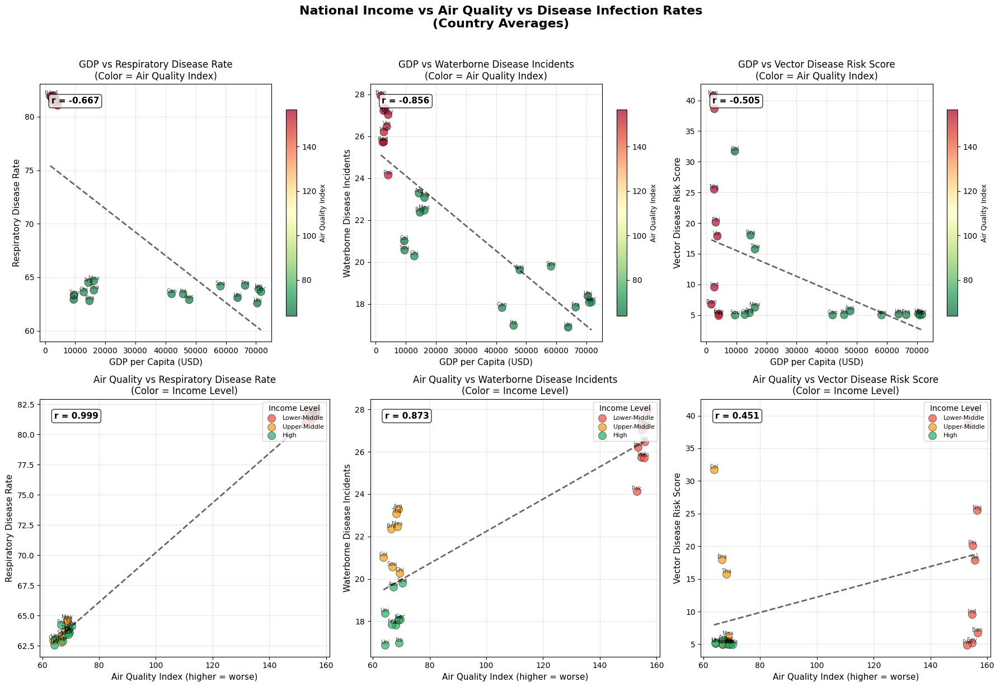


CORRELATION MATRIX: Income, Air Quality, and Disease Rates
                              gdp_per_capita_usd  air_quality_index  pm25_ugm3  respiratory_disease_rate  waterborne_disease_incidents  vector_disease_risk_score
gdp_per_capita_usd                         1.000             -0.664     -0.660                    -0.667                        -0.856                     -0.505
air_quality_index                         -0.664              1.000      1.000                     0.999                         0.873                      0.451
pm25_ugm3                                 -0.660              1.000      1.000                     0.999                         0.872                      0.450
respiratory_disease_rate                  -0.667              0.999      0.999                     1.000                         0.878                      0.457
waterborne_disease_incidents              -0.856              0.873      0.872                     0.878                         1

In [ ]:
# Correlation Analysis: National Income vs Air Quality vs Disease Rates

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings

# Suppress LAPACK warnings for polyfit
warnings.filterwarnings('ignore', message='.*DLASCL.*')

# Aggregate data by country for clearer visualization
country_avg = data.groupby(['country_name', 'income_level'], observed=True).agg({
    'gdp_per_capita_usd': 'mean',
    'air_quality_index': 'mean',
    'pm25_ugm3': 'mean',
    'respiratory_disease_rate': 'mean',
    'waterborne_disease_incidents': 'mean',
    'vector_disease_risk_score': 'mean'
}).reset_index()

# Define disease columns for analysis
disease_cols = ['respiratory_disease_rate', 'waterborne_disease_incidents', 'vector_disease_risk_score']
disease_labels = ['Respiratory Disease Rate', 'Waterborne Disease Incidents', 'Vector Disease Risk Score']

# Helper function to safely add trend line
def add_trend_line(ax, x_data, y_data):
    """Add a trend line with error handling for edge cases."""
    try:
        # Check if we have enough variance in the data
        if x_data.std() > 0 and y_data.std() > 0 and len(x_data) > 2:
            z = np.polyfit(x_data, y_data, 1)
            p = np.poly1d(z)
            x_line = np.linspace(x_data.min(), x_data.max(), 100)
            ax.plot(x_line, p(x_line), 'k--', linewidth=2, alpha=0.6)
    except Exception:
        pass  # Skip trend line if fitting fails

# Create figure with 2 rows x 3 columns
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
fig.suptitle('National Income vs Air Quality vs Disease Infection Rates\n(Country Averages)',
             fontsize=16, fontweight='bold', y=1.02)

# Color palette for income levels
income_colors = {'Lower-Middle': '#e74c3c', 'Upper-Middle': '#f39c12', 'High': '#27ae60'}

# Row 1: GDP per Capita vs Disease Rates (colored by Air Quality)
for idx, (disease_col, disease_label) in enumerate(zip(disease_cols, disease_labels)):
    ax = axes[0, idx]
    scatter = ax.scatter(
        country_avg['gdp_per_capita_usd'],
        country_avg[disease_col],
        c=country_avg['air_quality_index'],
        cmap='RdYlGn_r',  # Red = poor air quality, Green = good
        s=100,
        alpha=0.7,
        edgecolors='black',
        linewidth=0.5
    )

    # Add country labels
    for i, row in country_avg.iterrows():
        ax.annotate(row['country_name'][:3],
                   (row['gdp_per_capita_usd'], row[disease_col]),
                   fontsize=7, alpha=0.7, ha='center', va='bottom')

    # Add trend line safely
    add_trend_line(ax, country_avg['gdp_per_capita_usd'], country_avg[disease_col])

    # Calculate correlation
    corr = country_avg['gdp_per_capita_usd'].corr(country_avg[disease_col])
    ax.text(0.05, 0.95, f'r = {corr:.3f}', transform=ax.transAxes,
            fontsize=11, fontweight='bold', verticalalignment='top',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

    ax.set_xlabel('GDP per Capita (USD)', fontsize=11)
    ax.set_ylabel(disease_label, fontsize=11)
    ax.set_title(f'GDP vs {disease_label}\n(Color = Air Quality Index)', fontsize=12)
    ax.grid(True, alpha=0.3)

    # Add colorbar
    cbar = plt.colorbar(scatter, ax=ax, shrink=0.8)
    cbar.set_label('Air Quality Index', fontsize=9)

# Row 2: Air Quality vs Disease Rates (colored by Income Level)
for idx, (disease_col, disease_label) in enumerate(zip(disease_cols, disease_labels)):
    ax = axes[1, idx]

    for income_level in ['Lower-Middle', 'Upper-Middle', 'High']:
        subset = country_avg[country_avg['income_level'] == income_level]
        if len(subset) > 0:
            ax.scatter(
                subset['air_quality_index'],
                subset[disease_col],
                c=income_colors[income_level],
                s=100,
                alpha=0.7,
                edgecolors='black',
                linewidth=0.5,
                label=income_level
            )

            # Add country labels
            for i, row in subset.iterrows():
                ax.annotate(row['country_name'][:3],
                           (row['air_quality_index'], row[disease_col]),
                           fontsize=7, alpha=0.7, ha='center', va='bottom')

    # Add overall trend line safely
    add_trend_line(ax, country_avg['air_quality_index'], country_avg[disease_col])

    # Calculate correlation
    corr = country_avg['air_quality_index'].corr(country_avg[disease_col])
    ax.text(0.05, 0.95, f'r = {corr:.3f}', transform=ax.transAxes,
            fontsize=11, fontweight='bold', verticalalignment='top',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

    ax.set_xlabel('Air Quality Index (higher = worse)', fontsize=11)
    ax.set_ylabel(disease_label, fontsize=11)
    ax.set_title(f'Air Quality vs {disease_label}\n(Color = Income Level)', fontsize=12)
    ax.grid(True, alpha=0.3)
    ax.legend(title='Income Level', loc='upper right', fontsize=8)

plt.tight_layout()
plt.show()

# Print correlation matrix
print("\n" + "="*70)
print("CORRELATION MATRIX: Income, Air Quality, and Disease Rates")
print("="*70)
correlation_cols = ['gdp_per_capita_usd', 'air_quality_index', 'pm25_ugm3'] + disease_cols
corr_matrix = country_avg[correlation_cols].corr()
print(corr_matrix.round(3).to_string())


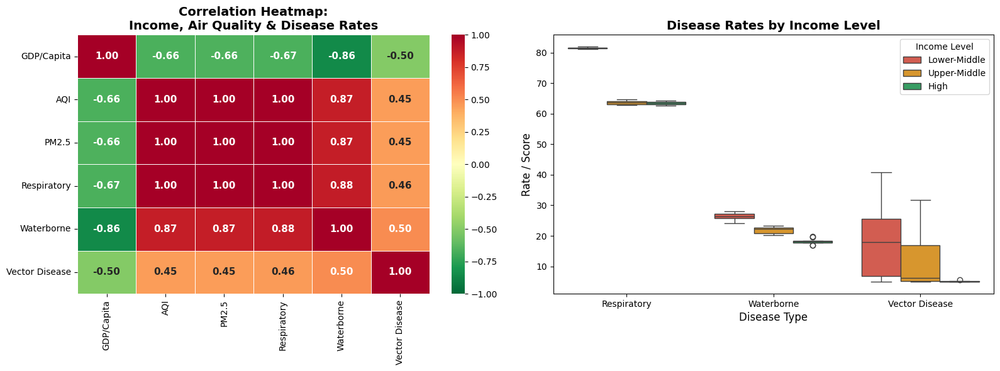


SUMMARY: Average Values by Income Level
              air_quality_index  pm25_ugm3  respiratory_disease_rate  waterborne_disease_incidents  vector_disease_risk_score
income_level                                                                                                                 
Lower-Middle             154.97     103.35                     81.51                         26.42                      18.80
Upper-Middle              67.48      44.33                     63.65                         21.86                      12.44
High                      67.65      44.87                     63.48                         18.17                       5.13


In [ ]:
# Heatmap and Summary Statistics

fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Define columns again for this cell (in case cells run independently)
disease_cols_local = ['respiratory_disease_rate', 'waterborne_disease_incidents', 'vector_disease_risk_score']
income_colors_local = {'Lower-Middle': '#e74c3c', 'Upper-Middle': '#f39c12', 'High': '#27ae60'}

# Left: Correlation heatmap
ax1 = axes[0]
correlation_cols = ['gdp_per_capita_usd', 'air_quality_index', 'pm25_ugm3',
                    'respiratory_disease_rate', 'waterborne_disease_incidents', 'vector_disease_risk_score']
corr_matrix = country_avg[correlation_cols].corr()

# Rename for cleaner display
rename_map = {
    'gdp_per_capita_usd': 'GDP/Capita',
    'air_quality_index': 'AQI',
    'pm25_ugm3': 'PM2.5',
    'respiratory_disease_rate': 'Respiratory',
    'waterborne_disease_incidents': 'Waterborne',
    'vector_disease_risk_score': 'Vector Disease'
}
corr_display = corr_matrix.rename(index=rename_map, columns=rename_map)

sns.heatmap(corr_display, annot=True, fmt='.2f', cmap='RdYlGn_r', center=0,
            vmin=-1, vmax=1, linewidths=0.5, ax=ax1,
            annot_kws={'size': 11, 'fontweight': 'bold'})
ax1.set_title('Correlation Heatmap:\nIncome, Air Quality & Disease Rates', fontsize=14, fontweight='bold')

# Right: Box plot showing disease rates by income level
ax2 = axes[1]
# Melt data for easier plotting
melted = country_avg.melt(
    id_vars=['income_level'],
    value_vars=disease_cols_local,
    var_name='Disease Type',
    value_name='Rate'
)
melted['Disease Type'] = melted['Disease Type'].map({
    'respiratory_disease_rate': 'Respiratory',
    'waterborne_disease_incidents': 'Waterborne',
    'vector_disease_risk_score': 'Vector Disease'
})

sns.boxplot(data=melted, x='Disease Type', y='Rate', hue='income_level',
            palette=income_colors_local, ax=ax2)
ax2.set_title('Disease Rates by Income Level', fontsize=14, fontweight='bold')
ax2.set_xlabel('Disease Type', fontsize=12)
ax2.set_ylabel('Rate / Score', fontsize=12)
ax2.legend(title='Income Level', loc='upper right')

plt.tight_layout()
plt.show()

# Summary statistics by income level
print("\n" + "="*70)
print("SUMMARY: Average Values by Income Level")
print("="*70)
summary_cols = ['air_quality_index', 'pm25_ugm3'] + disease_cols_local
summary = data.groupby('income_level', observed=True)[summary_cols].mean().round(2)
print(summary.to_string())
